<img src="https://docs.google.com/uc?id=1l7172E6yCLTPqsgy3OQOdJMoHWOudF2L"/>

<br>
<center><h1>Exploratory Data Analysis</h1></center>

The purpose of this analysis is to answer the CEO questions and make a conclusion about insights that can be useful to make better decisions to buy houses and increase the company revenue .

# 1. Solution strategy
    -> Project purpose
        -- 1. Which houses the CEO should be purchased and at what price to buy?
        -- 2. With the house in company possession, what is the best moment to be sold, and for which price?
        -- 3. The company should do a restoration to increase the price sale? What are the recommendations? For each 
        restoration recommendation, how the price increases?

    -> Solution proposal
        -- 1. Table (House | Purchase price) by EDA
            -- Houses that are cheap with high indicators of valuation
        -- 2. Table (House | Sale date | Sale price) --> ML Model
        -- 3. Table (House | Restoration (0, 1)
                    (House | Restoration Features | Sale price correlation)
                    
# 2. Solution steps
    -- C1. Understanding data (Finding data inconsistency and cleaning)
        -- transform date into datetime
        -- drop bedrooms < 1 and bedrooms outliers
        -- drop grade == 3
        -- knowing the features
    -- C2. Feature engineering (New features that can be useful to data model)
    -- C3. Hypotheses   
        -- H1. Oldest houses have an average higher price;
        -- H2. Houses that were renovated are more expensive than those that haven't been renovated and built in the same year;
        -- H3. The waterfront has no impact on the purchase price;
        -- H4. Houses with more sqft_living are more expensive;
        -- H5. The number of bedrooms are the more important categorical feature to increase the price purchase    
        -- H6. Mountain houses have a higher price;
        -- H7. Seattle has the highest value houses
        -- H8. Houses with basement living space are cheaper than no underground level    
        -- H9. Houses with repeated ids were bought for lower prices
        -- H10. The price of houses purchased doesn't influence by periods, like month or season.
    -- C4. Exploratory Data Analysis 
        -- Hypotheses validation
        -- Multivariate Analysis
    -- C6. Model Pipeline (Data obtaining until model training)

# 1.0 Imports

In [1]:
import numpy as np
import pandas as pd
from datetime import datetime as dt
from scipy import stats
from sklearn.cluster import KMeans
from scipy.stats import mannwhitneyu
from scipy.stats import f_oneway
from statistics import median

In [2]:
# data visualization
import plotly.express as px
import seaborn as sns
from matplotlib import pyplot as plt

# data visualization config
from IPython.core.pylabtools import figsize
%matplotlib inline
sns.set(figsize(15, 8))
sns.set(font_scale=1.35)
pd.set_option("display.max_columns", None)
pd.set_option('display.float_format', lambda x: '%.2f' % x)

mapbox_token = 'pk.eyJ1IjoicGNlc2FyY29zdGEiLCJhIjoiY2tmY2s3NHJpMDM1NzJ4cXR4YnltaTFobCJ9.kbs5w8wt1gjUtfvgGvXk0A'
px.set_mapbox_access_token(mapbox_token)

# 2.0 Loading data

In [3]:
data = pd.read_csv('./data/kc_house_data.csv')
data.head().T

,0,1,2,3,4
id,7129300520,6414100192,5631500400,2487200875,1954400510
date,20141013T000000,20141209T000000,20150225T000000,20141209T000000,20150218T000000
price,221900.00,538000.00,180000.00,604000.00,510000.00
bedrooms,3,3,2,4,3
bathrooms,1.00,2.25,1.00,3.00,2.00
sqft_living,1180,2570,770,1960,1680
sqft_lot,5650,7242,10000,5000,8080
floors,1.00,2.00,1.00,1.00,1.00
waterfront,0,0,0,0,0
view,0,0,0,0,0


In [4]:
data.shape

(21613, 21)

### features dictionary

![image.png](attachment:image.png)

# C1) Understanding data

### C2.1 Checking dataset attributes

In [5]:
pd.DataFrame(data.dtypes).T

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,int64,object,float64,int64,float64,int64,int64,float64,int64,int64,int64,int64,int64,int64,int64,int64,int64,float64,float64,int64,int64


Features list:
- date: object type, needs to be datetime
- bathrooms: float, bathroom note*
- floors: a half floor is a detached home that has a second floor that is about half the size of the main floor

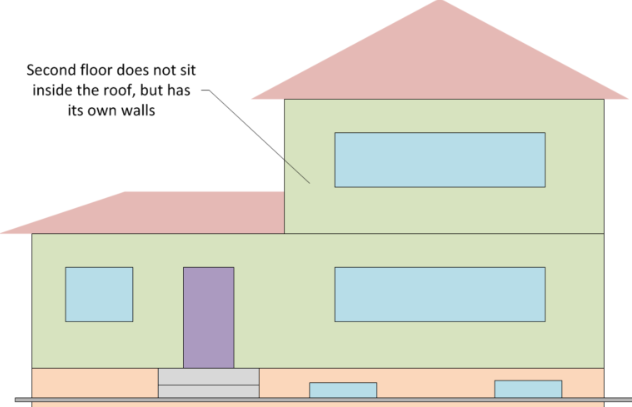

---
---

<font color='blue'>__*bathroom note:__</font> 

In the United States, bathrooms are generally categorized as: 
- __full bathroom__: containing four plumbing fixtures bathtub/shower or separate shower, toilet, and sink 
- __1/2 bath__: containing just a toilet and sink
- __3/4 bath__: containing toilet, sink, and shower 

_e.g. __2.5 baths__ would mean 2 full baths and 1 half bath_

Although the terms vary from market to market. In some U.S. markets, a toilet, sink, and shower are considered a "full bath"

In [6]:
# --> transforming date into datetime

# are dates in same pattern?
#data['date'].unique()

def transform_str_into_date(str_date):
    year = str_date[:4]
    month = str_date[4:6]
    day = str_date[6:8]
    return dt.strptime(f'{year}-{month}-{day}', '%Y-%m-%d')

data['date'] = data['date'].apply(transform_str_into_date)
data[['date']].sample(10).T

,16551,10072,1630,14150,9518,15798,8358,5450,16962,7754
date,2014-11-24,2015-05-01,2015-01-07,2014-12-02,2014-09-16,2015-03-12,2014-09-11,2015-01-23,2014-10-29,2014-06-02


In [7]:
# --> null values

pd.DataFrame(data.isna().sum(), columns=['qty_null_values'])

,qty_null_values
id,0
date,0
price,0
bedrooms,0
bathrooms,0
sqft_living,0
sqft_lot,0
floors,0
waterfront,0
view,0


In [8]:
# duplcates
data.duplicated().sum()

0

##### checking for unique values in each feature

In [9]:
pd.DataFrame([data.nunique(), data.count() - data.nunique(), 1 - data.nunique()/data.count()], index=['unique_values', 'non-unique_values','%_non-unique_values']).T

,unique_values,non-unique_values,%_non-unique_values
id,21436.00,177.00,0.01
date,372.00,21241.00,0.98
price,4028.00,17585.00,0.81
bedrooms,13.00,21600.00,1.00
bathrooms,30.00,21583.00,1.00
sqft_living,1038.00,20575.00,0.95
sqft_lot,9782.00,11831.00,0.55
floors,6.00,21607.00,1.00
waterfront,2.00,21611.00,1.00
view,5.00,21608.00,1.00


In [10]:
# -> there are non-unique id's, let's check out

In [11]:
idx_duplicate = data.groupby('id').count().query('date >= 2').index
data.index = data['id']
data.index.name = None
data.loc[idx_duplicate]

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
1000102,1000102,2014-09-16,280000.00,6,3.00,2400,9373,2.00,0,0,3,7,2400,0,1991,0,98002,47.33,-122.21,2060,7316
1000102,1000102,2015-04-22,300000.00,6,3.00,2400,9373,2.00,0,0,3,7,2400,0,1991,0,98002,47.33,-122.21,2060,7316
7200179,7200179,2014-10-16,150000.00,2,1.00,840,12750,1.00,0,0,3,6,840,0,1925,0,98055,47.48,-122.21,1480,6969
7200179,7200179,2015-04-24,175000.00,2,1.00,840,12750,1.00,0,0,3,6,840,0,1925,0,98055,47.48,-122.21,1480,6969
109200390,109200390,2014-08-20,245000.00,3,1.75,1480,3900,1.00,0,0,4,7,1480,0,1980,0,98023,47.30,-122.37,1830,6956
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9828200460,9828200460,2015-01-06,430000.00,2,1.00,700,4800,1.00,0,0,3,7,700,0,1922,0,98122,47.61,-122.30,1440,4800
9834200305,9834200305,2014-07-16,350000.00,3,1.00,1790,3876,1.50,0,0,5,7,1090,700,1904,0,98144,47.58,-122.29,1360,4080
9834200305,9834200305,2015-02-10,615000.00,3,1.00,1790,3876,1.50,0,0,5,7,1090,700,1904,0,98144,47.58,-122.29,1360,4080
9834200885,9834200885,2014-07-17,360000.00,4,2.50,2080,4080,1.00,0,0,5,7,1040,1040,1962,0,98144,47.57,-122.29,1340,4080


In [12]:
# duplicate ids are the same house but sold in different periods ?
# data.groupby(['id', 'date']).count().query('price >= 2') # --> empty query
# so, duplicate ids are the same house sold in different periods

##### are there different houses in the same location (lat, long)?

In [13]:
same_location_houses = data.groupby(['lat','long']).nunique().query('id >= 2')
same_location_houses

id  date  price  bedrooms  bathrooms  sqft_living  sqft_lot  \
lat   long                                                                   
47.19 -121.97   2     2      2         1          2            1         2   
47.20 -122.00   2     2      2         2          2            2         2   
47.21 -122.01   2     2      2         2          2            2         2   
      -121.99   2     2      2         1          1            2         2   
47.26 -122.28   2     2      2         1          2            2         2   
...            ..   ...    ...       ...        ...          ...       ...   
47.77 -122.28   2     2      2         1          1            2         2   
47.78 -122.38   2     2      2         1          2            2         2   
      -122.30   2     2      2         1          1            2         1   
      -122.24   2     2      2         2          1            1         2   
      -122.24   2     2      2         1          1            2         2   

               floors  waterfront  view  condition  grade  sqft_above  \
lat   long                                                              
47.19 -121.97       1           1     1          1      1           1   
47.20 -122.00       2           1     1          2      2           2   
47.21 -122.01       1           1     1          1      1           2   
      -121.99       2           1     1          1      1           2   
47.26 -122.28       1           1     1          2      2           2   
...               ...         ...   ...        ...    ...         ...   
47.77 -122.28       2           1     1          1      1           2   
47.78 -122.38       2           1     1          1      1           2   
      -122.30       2           1     1          2      1           2   
      -122.24       1           1     1          1      1           1   
      -122.24       1           1     1          1      1           2   

               sqft_basement  yr_built  yr_renovated  zipcode  lat  long  \
lat   long                                                                 
47.19 -121.97              1         1             1        1    1     1   
47.20 -122.00              1         2             2        1    1     1   
47.21 -122.01              1         1             1        1    1     1   
      -121.99              1         2             2        1    1     1   
47.26 -122.28              1         2             1        1    1     1   
...                      ...       ...           ...      ...  ...   ...   
47.77 -122.28              2         2             1        1    1     1   
47.78 -122.38              1         1             1        1    1     1   
      -122.30              1         2             1        1    1     1   
      -122.24              1         1             1        1    1     1   
      -122.24              1         1             1        1    1     1   

               sqft_living15  sqft_lot15  
lat   long                                
47.19 -121.97              1           1  
47.20 -122.00              2           1  
47.21 -122.01              2           2  
      -121.99              2           2  
47.26 -122.28              2           2  
...                      ...         ...  
47.77 -122.28              2           1  
47.78 -122.38              2           1  
      -122.30              2           1  
      -122.24              2           2  
      -122.24              2           2  

[560 rows x 21 columns]

In [14]:
same_location_idx = same_location_houses.index.values

In [15]:
i = 15
data.query(f'lat == {same_location_idx[i][0]} & long == {same_location_idx[i][1]}')

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
4239400740,4239400740,2014-07-16,192950.00,3,1.00,1170,3330,2.00,0,0,4,6,1170,0,1969,0,98092,47.32,-122.18,1090,3330
4239400730,4239400730,2014-06-25,152000.00,3,1.00,1090,3264,1.00,0,0,4,6,1090,0,1969,0,98092,47.32,-122.18,1090,3330


#### Houses purchase in advance?

In [16]:
data['year'] = data['date'].apply(lambda x: x.year)
data['yr_built_yr_sale_dif'] = data['year'] - data['yr_built']

In [17]:
data.query('yr_built_yr_sale_dif < 0')

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,year,yr_built_yr_sale_dif
1832100030,1832100030,2014-06-25,597326.00,4,4.00,3570,8250,2.00,0,0,3,10,2860,710,2015,0,98040,47.58,-122.23,2230,10000,2014,-1
3076500830,3076500830,2014-10-29,385195.00,1,1.00,710,6000,1.50,0,0,3,6,710,0,2015,0,98144,47.58,-122.32,1440,4800,2014,-1
9520900210,9520900210,2014-12-31,614285.00,5,2.75,2730,6401,2.00,0,0,3,8,2730,0,2015,0,98072,47.77,-122.16,2520,6126,2014,-1
1250200495,1250200495,2014-06-24,455000.00,2,1.50,1200,1259,2.00,0,0,3,8,1000,200,2015,0,98144,47.60,-122.30,1320,1852,2014,-1
2770601530,2770601530,2014-08-26,500000.00,2,2.25,1570,1269,2.00,0,0,3,9,1280,290,2015,0,98199,47.65,-122.39,1570,6000,2014,-1
9126100346,9126100346,2014-06-17,350000.00,3,2.00,1380,3600,3.00,0,0,3,8,1380,0,2015,0,98122,47.61,-122.31,1480,3600,2014,-1
9126100765,9126100765,2014-08-01,455000.00,3,1.75,1320,1014,3.00,0,0,3,9,1320,0,2015,0,98122,47.60,-122.31,1380,1495,2014,-1
9310300160,9310300160,2014-08-28,357000.00,5,2.50,2990,9240,2.00,0,0,3,8,2990,0,2015,0,98133,47.74,-122.35,1970,18110,2014,-1
1257201420,1257201420,2014-07-09,595000.00,4,3.25,3730,4560,2.00,0,0,3,9,2760,970,2015,0,98103,47.67,-122.33,1800,4560,2014,-1
6058600220,6058600220,2014-07-31,230000.00,3,1.50,1040,1264,2.00,0,0,3,9,900,140,2015,0,98144,47.60,-122.30,1350,3000,2014,-1


### C2.2 Univariate analysis

In [18]:
data.drop('id', axis=1).describe().T

,count,mean,std,min,25%,50%,75%,max
price,21613.00,540088.14,367127.20,75000.00,321950.00,450000.00,645000.00,7700000.00
bedrooms,21613.00,3.37,0.93,0.00,3.00,3.00,4.00,33.00
bathrooms,21613.00,2.11,0.77,0.00,1.75,2.25,2.50,8.00
sqft_living,21613.00,2079.90,918.44,290.00,1427.00,1910.00,2550.00,13540.00
sqft_lot,21613.00,15106.97,41420.51,520.00,5040.00,7618.00,10688.00,1651359.00
floors,21613.00,1.49,0.54,1.00,1.00,1.50,2.00,3.50
waterfront,21613.00,0.01,0.09,0.00,0.00,0.00,0.00,1.00
view,21613.00,0.23,0.77,0.00,0.00,0.00,0.00,4.00
condition,21613.00,3.41,0.65,1.00,3.00,3.00,4.00,5.00
grade,21613.00,7.66,1.18,1.00,7.00,7.00,8.00,13.00


#### 1. __price__:
    - the minimum sale price is 75K -- max 7.7M
    - the difference between median and max price sale is monstrous, indicating that the company operates with several houses types (cheap and expensive). However the standard deviation is small compared with min and max values.

In [19]:
q1 = data.query(f"price <= {data['price'].quantile(0.25)}")['price'].count()
q2 = data.query(f"price > {data['price'].quantile(0.25)} & price < {data['price'].quantile(0.75)}")['price']
q4 = data.query(f"price >= {data['price'].quantile(0.75)}")['price'].count()
print(q1, q2.count(), q4)

5404 10796 5413


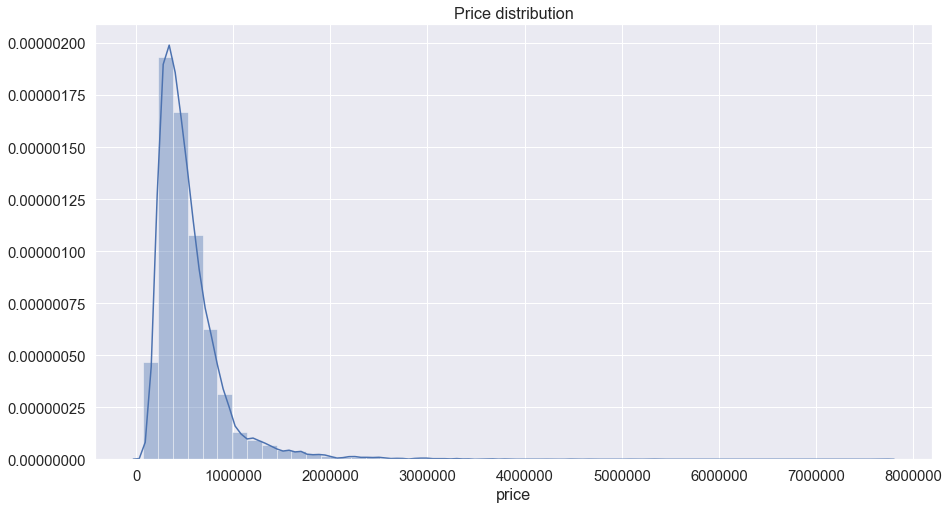

In [20]:
g = sns.distplot(data['price']);
g.set_title('Price distribution');

#### 2. bedrooms:
    - there are houses with no bedrooms and the max value is 33, even with the 4th quartile in 4

In [21]:
# data.query('bedrooms < 1')

# droping bedrooms < 1
idx_no_bedrooms = data.query('bedrooms < 1').index
data.drop(idx_no_bedrooms, inplace = True)
print(f'bedrooms < 1: {len(idx_no_bedrooms)} rows dropped')

bedrooms < 1: 13 rows dropped


In [22]:
# qty_houses by qty_bedroom
pd.DataFrame(data['bedrooms'].value_counts().sort_index()).T

,1,2,3,4,5,6,7,8,9,10,11,33
bedrooms,199,2760,9824,6882,1601,272,38,13,6,3,1,1


In [23]:
data.query('bedrooms >= 11')

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,year,yr_built_yr_sale_dif
1773100755,1773100755,2014-08-21,520000.00,11,3.00,3000,4960,2.00,0,0,3,7,2400,600,1918,1999,98106,47.56,-122.36,1420,4960,2014,96
2402100895,2402100895,2014-06-25,640000.00,33,1.75,1620,6000,1.00,0,0,5,7,1040,580,1947,0,98103,47.69,-122.33,1330,4700,2014,67


33 bedrooms and...1.75 bathrooms...DROP! DROP!

In [24]:
idx_bedrooms_outlier = data.query('bedrooms == 33').index
data.drop(idx_bedrooms_outlier, inplace=True)
print(f'bedrooms outliers: {len(idx_bedrooms_outlier)} rows dropped')

bedrooms outliers: 1 rows dropped


are there any other cases, that have many more bedrooms than bathrooms?

In [25]:
more_bed_than_bath = data.copy()
more_bed_than_bath['bed_bath_prop'] = more_bed_than_bath['bedrooms'] / more_bed_than_bath['bathrooms']

In [26]:
more_bed_than_bath.query('bathrooms >= 1')[['bed_bath_prop']].describe().T

,count,mean,std,min,25%,50%,75%,max
bed_bath_prop,21521.00,1.75,0.65,0.40,1.33,1.60,2.00,7.00


In [27]:
#more_bed_than_bath.query('bed_bath_prop > 5')

#### 3. bathrooms:
    - there are houses with no bathrooms and some houses have 1/4 bath

In [28]:
# data.query('bathrooms < 1').describe()

# if bathrooms <= 0.5 then 0
# if bathrooms > 0.5 and < 1 then 1

drop_bathrooms = data.query('bathrooms <= 0.5').index
data.drop(drop_bathrooms, inplace = True)

# reducing the dimensionality of bathrooms (2.25 bathrooms => 2 | 2.75 => 3 | 2.5 => 2.5; etc.)
data['bathrooms'] = round(data['bathrooms'])

#### 4. sqft_living

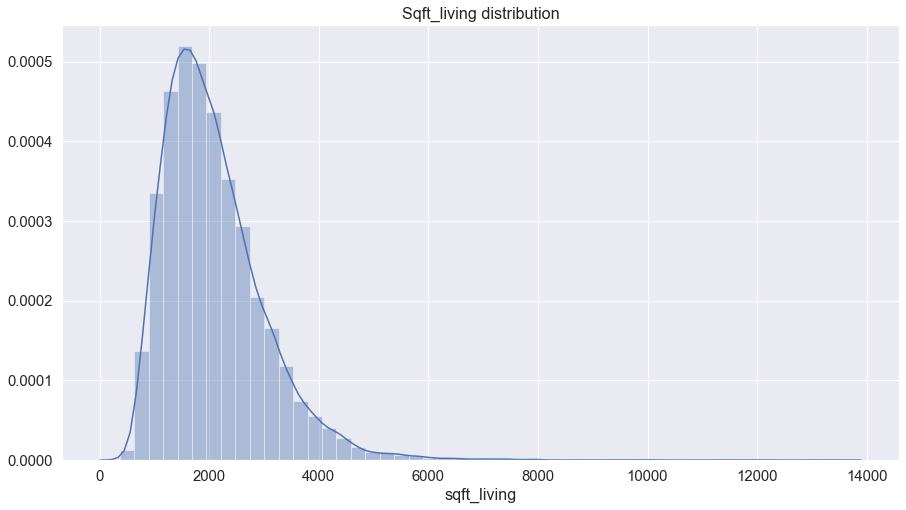

In [29]:
c_data = data['sqft_living']
g = sns.distplot(c_data);
g.set_title('Sqft_living distribution');

In [30]:
c_data.skew(), c_data.kurtosis()

(1.4733963943183068, 5.2528568664563)

In [31]:
# COMENTAR DIREITO
# sqft_living > more values above the mean (skew > 0) and 

In [32]:
data.query('sqft_living < 500')

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,year,yr_built_yr_sale_dif
8658300340,8658300340,2014-05-23,80000.00,1,1.00,430,5050,1.00,0,0,2,4,430,0,1912,0,98014,47.65,-121.91,1200,7500,2014,102
1723049033,1723049033,2014-06-20,245000.00,1,1.00,380,15000,1.00,0,0,3,5,380,0,1963,0,98168,47.48,-122.32,1170,15000,2014,51
3523029041,3523029041,2014-10-09,290000.00,2,1.00,440,8313,1.00,1,3,4,5,440,0,1943,0,98070,47.43,-122.51,880,26289,2014,71
1437500015,1437500015,2014-07-09,150000.00,3,1.00,490,38500,1.50,0,0,4,5,490,0,1959,0,98014,47.71,-121.31,800,18297,2014,55
7849202585,7849202585,2014-09-04,170000.00,1,1.00,480,4560,1.00,0,0,3,5,480,0,1922,0,98065,47.53,-121.83,890,4803,2014,92
6303400395,6303400395,2015-01-30,325000.00,1,1.00,410,8636,1.00,0,0,2,4,410,0,1953,0,98146,47.51,-122.36,1190,8636,2015,62
4322200105,4322200105,2015-03-31,229050.00,1,1.00,420,3298,1.00,0,0,4,4,420,0,1949,0,98136,47.54,-122.39,1460,4975,2015,66
8655900162,8655900162,2015-02-19,156000.00,1,1.00,470,15000,1.00,0,0,3,4,470,0,1947,0,98014,47.66,-121.91,1730,22500,2015,68
7549801385,7549801385,2014-06-12,280000.00,1,1.00,420,6720,1.00,0,0,3,5,420,0,1922,0,98108,47.55,-122.31,1420,6720,2014,92
1320069249,1320069249,2014-10-20,192500.00,1,1.00,470,63737,1.00,0,2,5,5,470,0,1924,0,98022,47.22,-121.98,1350,46762,2014,90


In [33]:
# are there more houses with space living or land space?
data.loc[data['sqft_lot'] < data['sqft_living']]

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,year,yr_built_yr_sale_dif
9528102996,9528102996,2014-12-07,549000.00,3,2.00,1540,1044,3.00,0,0,3,8,1540,0,2014,0,98115,47.68,-122.32,1580,3090,2014,0
3362400431,3362400431,2014-06-26,518500.00,3,4.00,1590,1102,3.00,0,0,3,8,1590,0,2010,0,98103,47.68,-122.35,1620,3166,2014,4
7234600798,7234600798,2015-02-10,425000.00,3,2.00,1120,1100,2.00,0,0,3,8,820,300,2008,0,98122,47.61,-122.31,1590,1795,2015,7
7821200390,7821200390,2014-08-06,450000.00,3,2.00,1290,1213,3.00,0,0,3,8,1290,0,2001,0,98103,47.66,-122.34,1290,3235,2014,13
7899800860,7899800860,2015-03-19,259950.00,2,2.00,1070,649,2.00,0,0,3,9,720,350,2008,0,98106,47.52,-122.36,1070,928,2015,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1972201967,1972201967,2014-10-31,520000.00,2,2.00,1530,981,3.00,0,0,3,8,1480,50,2006,0,98103,47.65,-122.35,1530,1282,2014,8
5100403806,5100403806,2015-04-07,467000.00,3,2.00,1425,1179,3.00,0,0,3,8,1425,0,2008,0,98125,47.70,-122.32,1285,1253,2015,7
9834201367,9834201367,2015-01-26,429000.00,3,2.00,1490,1126,3.00,0,0,3,8,1490,0,2014,0,98144,47.57,-122.29,1400,1230,2015,1
2997800021,2997800021,2015-02-19,475000.00,3,2.00,1310,1294,2.00,0,0,3,8,1180,130,2008,0,98116,47.58,-122.41,1330,1265,2015,7


#### 5. sqft_lot

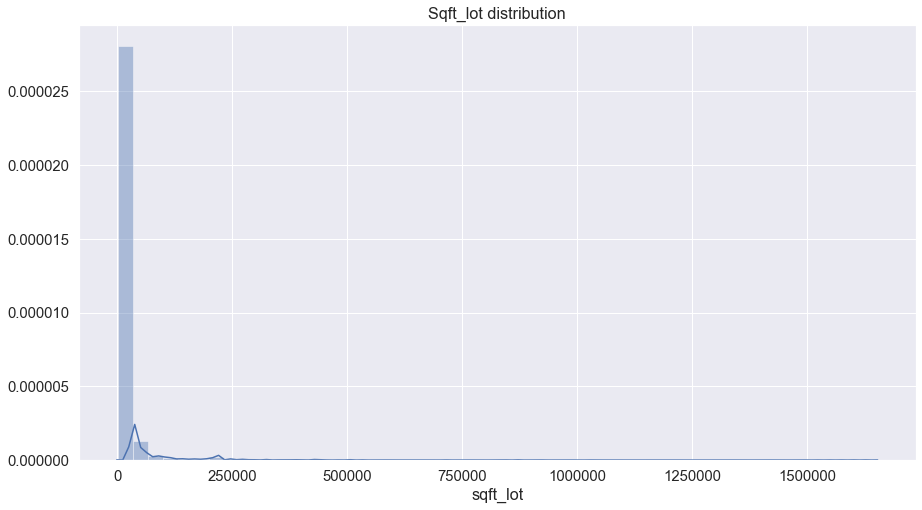

In [34]:
g = sns.distplot(data['sqft_lot'])
g.set_title('Sqft_lot distribution');

In [35]:
c_data = data['sqft_lot']
c_data.skew(), c_data.kurtosis()

(13.071185913958466, 285.4336648362259)

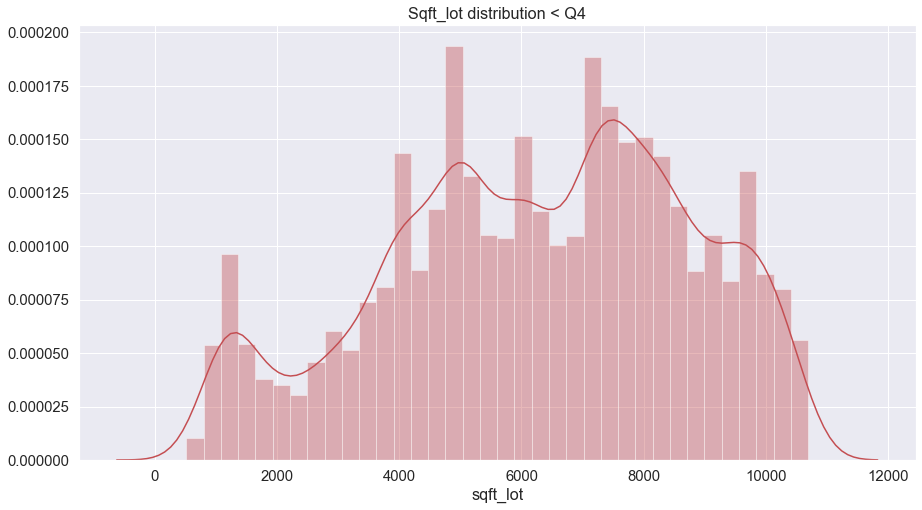

In [36]:
g = sns.distplot( data.query('sqft_lot < 10688')['sqft_lot'], color='r' );
g.set_title('Sqft_lot distribution < Q4');

#### 6. floors

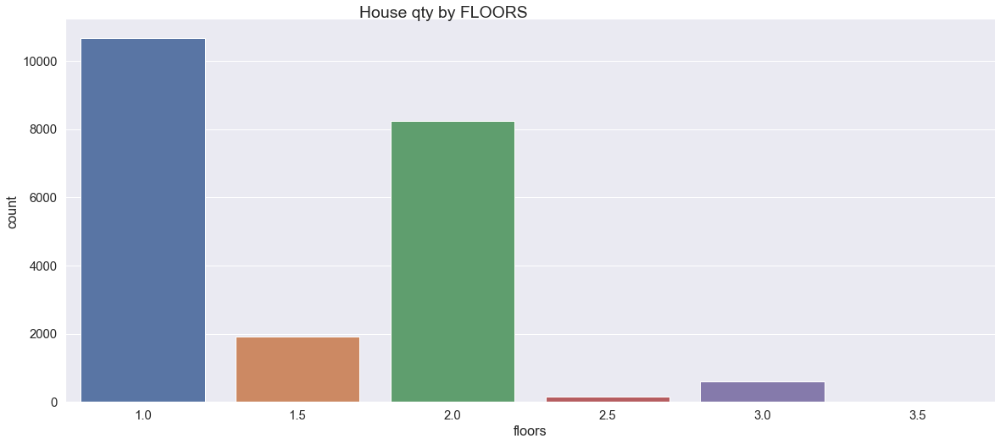

In [37]:
g = sns.catplot(x="floors", kind="count", data=data)
g.fig.set_size_inches(20,8)
g.fig.suptitle('House qty by FLOORS');

In [38]:
data['floors'].value_counts()

1.00    10669
2.00     8234
1.50     1910
3.00      611
2.50      161
3.50        7
Name: floors, dtype: int64

#### 7. waterfront & view

In [39]:
print('WATERFRONT: ')
print(data['waterfront'].value_counts())
print('------------------')
print("VIEW: ")
print(data['view'].value_counts())

WATERFRONT: 
0    21429
1      163
Name: waterfront, dtype: int64
------------------
VIEW: 
0    19470
2      961
3      510
1      332
4      319
Name: view, dtype: int64


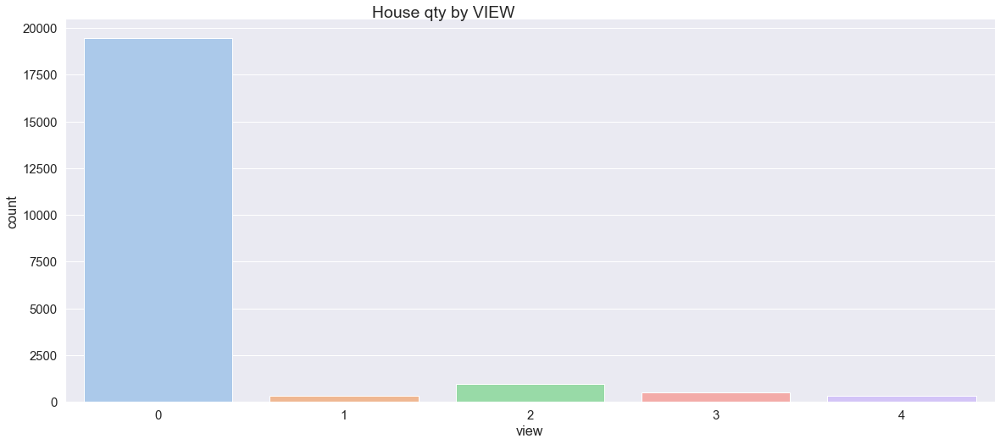

In [40]:
g = sns.catplot(x="view", kind="count", data=data, palette='pastel')
g.fig.set_size_inches(20,8)
g.fig.suptitle('House qty by VIEW');

#### 8. condition and grade

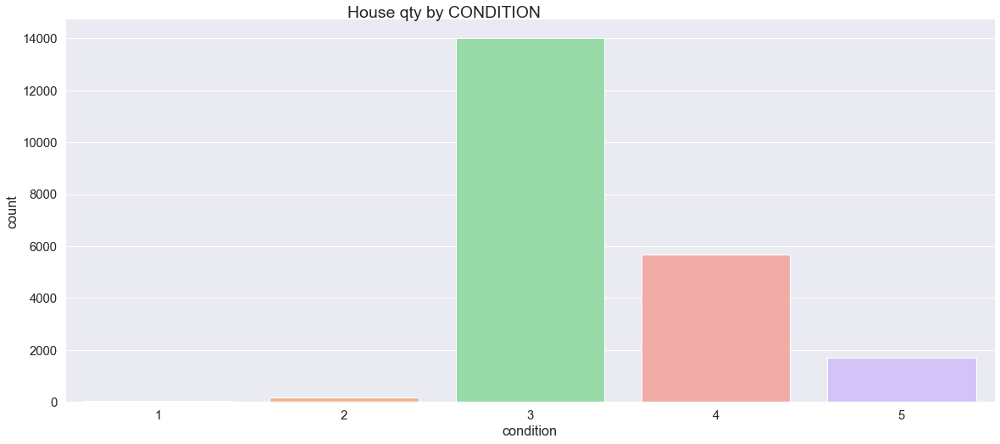

In [41]:
g = sns.catplot(x="condition", kind="count", data=data, palette='pastel')
g.fig.set_size_inches(20,8)
g.fig.suptitle('House qty by CONDITION');

In [42]:
data['condition'].value_counts().sort_index()

1       29
2      170
3    14017
4     5676
5     1700
Name: condition, dtype: int64

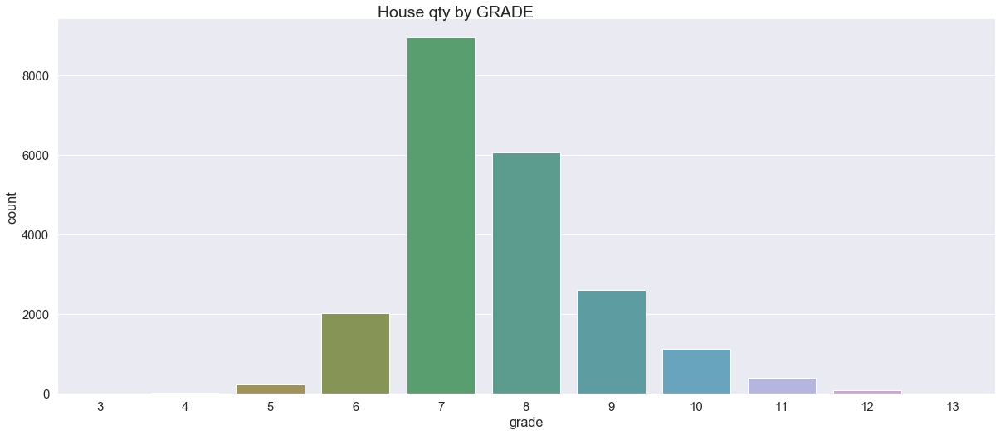

In [43]:
g = sns.catplot(x="grade", kind="count", data=data, saturation=.5)
g.fig.set_size_inches(20,8)
g.fig.suptitle('House qty by GRADE');

In [44]:
data['grade'].value_counts().sort_index()

3        1
4       27
5      241
6     2036
7     8973
8     6064
9     2615
10    1134
11     399
12      89
13      13
Name: grade, dtype: int64

In [45]:
# checking the house grade == 3
data.query('grade == 3')

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,year,yr_built_yr_sale_dif
2420069251,2420069251,2015-02-25,262000.00,1,1.00,520,12981,1.00,0,0,5,3,520,0,1920,0,98022,47.21,-122.00,1340,12233,2015,95


In [46]:
data.query('price > 260000 & price < 264000 & condition == 5')

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,year,yr_built_yr_sale_dif
2420069251,2420069251,2015-02-25,262000.00,1,1.00,520,12981,1.00,0,0,5,3,520,0,1920,0,98022,47.21,-122.00,1340,12233,2015,95
7942200050,7942200050,2015-01-23,261000.00,4,2.00,1820,9824,1.00,0,0,5,7,1820,0,1968,0,98042,47.38,-122.09,1410,11013,2015,47
3751606606,3751606606,2014-07-17,262500.00,3,2.00,2259,26831,1.50,0,3,5,7,1491,768,1908,0,98001,47.27,-122.27,1980,15794,2014,106
3903200050,3903200050,2015-03-24,263950.00,3,2.00,1700,11613,1.00,0,0,5,7,1180,520,1977,0,98092,47.29,-122.19,1500,12377,2015,38
9211500230,9211500230,2014-10-02,263000.00,4,3.00,1830,7315,1.00,0,0,5,7,1250,580,1979,0,98023,47.30,-122.38,1730,7208,2014,35


In [47]:
data.query('zipcode == 98022').describe()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,year,yr_built_yr_sale_dif
count,233.00,233.00,233.00,233.00,233.00,233.00,233.00,233.00,233.00,233.00,233.00,233.00,233.00,233.00,233.00,233.00,233.00,233.00,233.00,233.00,233.00,233.00
mean,4014550115.06,316742.39,3.16,1.91,1837.31,74233.91,1.32,0.00,0.63,3.73,7.18,1727.83,109.48,1971.54,128.30,98022.00,47.21,-122.00,1801.55,51488.42,2014.34,42.80
std,2665955754.02,122328.94,0.73,0.61,722.84,160272.65,0.44,0.00,1.12,0.76,0.95,646.31,324.97,29.05,490.20,0.00,0.02,0.03,491.92,88379.19,0.47,29.04
min,120069003.00,122000.00,1.00,1.00,470.00,3434.00,1.00,0.00,0.00,2.00,3.00,470.00,0.00,1900.00,0.00,98022.00,47.16,-122.09,980.00,4558.00,2014.00,0.00
25%,1920079062.00,235000.00,3.00,2.00,1350.00,8424.00,1.00,0.00,0.00,3.00,7.00,1280.00,0.00,1955.00,0.00,98022.00,47.20,-122.01,1450.00,8410.00,2014.00,21.00
50%,3220079017.00,280000.00,3.00,2.00,1670.00,10212.00,1.00,0.00,0.00,4.00,7.00,1600.00,0.00,1980.00,0.00,98022.00,47.21,-122.00,1690.00,9282.00,2014.00,34.00
75%,6018500015.00,350000.00,4.00,2.00,2160.00,50123.00,1.50,0.00,2.00,4.00,8.00,2040.00,0.00,1993.00,0.00,98022.00,47.21,-121.99,2092.00,47916.00,2015.00,60.00
max,9804500420.00,858000.00,6.00,4.00,4750.00,1651359.00,2.50,0.00,4.00,5.00,10.00,4750.00,1790.00,2014.00,2014.00,98022.00,47.28,-121.65,3310.00,560617.00,2015.00,115.00


In [48]:
idx_drop = data.query('grade == 3').index
data.drop(idx_drop, inplace = True)

#### 9. sqft_above & sqft_basement

- above > above ground level
- basement > below ground level

In [49]:
data['sqft_total'] = data['sqft_above'] + data['sqft_basement']
data.query('sqft_living != sqft_total')

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,year,yr_built_yr_sale_dif,sqft_total


In [50]:
data.query('sqft_above == 0 & sqft_basement > 0')

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,year,yr_built_yr_sale_dif,sqft_total


In [51]:
# does the sqft_basement influence the number of floors?
# if there is no one, so we'll assume it's true
data.query('floors == 1 & sqft_basement > 0')

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,year,yr_built_yr_sale_dif,sqft_total
2487200875,2487200875,2014-12-09,604000.00,4,3.00,1960,5000,1.00,0,0,5,7,1050,910,1965,0,98136,47.52,-122.39,1360,5000,2014,49,1960
7237550310,7237550310,2014-05-12,1225000.00,4,4.00,5420,101930,1.00,0,0,3,11,3890,1530,2001,0,98053,47.66,-122.00,4760,101930,2014,13,5420
2414600126,2414600126,2015-04-15,229500.00,3,1.00,1780,7470,1.00,0,0,3,7,1050,730,1960,0,98146,47.51,-122.34,1780,8113,2015,55,1780
1736800520,1736800520,2015-04-03,662500.00,3,2.00,3560,9796,1.00,0,0,3,8,1860,1700,1965,0,98007,47.60,-122.14,2210,8925,2015,50,3560
9212900260,9212900260,2014-05-27,468000.00,2,1.00,1160,6000,1.00,0,0,4,7,860,300,1942,0,98115,47.69,-122.29,1330,6000,2014,72,1160
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2924079034,2924079034,2014-09-25,332220.00,3,2.00,2580,47480,1.00,0,0,3,7,1360,1220,1953,0,98024,47.53,-121.93,1760,48181,2014,61,2580
6031400092,6031400092,2015-02-13,334950.00,5,3.00,2230,8642,1.00,0,0,3,7,1330,900,2014,0,98168,47.49,-122.32,2100,11056,2015,1,2230
3226049565,3226049565,2014-07-11,504600.00,5,3.00,2360,5000,1.00,0,0,3,7,1390,970,2008,0,98103,47.69,-122.33,2180,5009,2014,6,2360
8964800330,8964800330,2015-04-07,3000000.00,4,4.00,5090,14823,1.00,0,0,3,11,4180,910,2013,0,98004,47.62,-122.21,3030,12752,2015,2,5090


In [52]:
data.drop('sqft_total', axis = 1, inplace = True)

#### 10. yr_built & yr renoveted

In [53]:
np.array( sorted(data['yr_built'].unique()) )

array([1900, 1901, 1902, 1903, 1904, 1905, 1906, 1907, 1908, 1909, 1910,
       1911, 1912, 1913, 1914, 1915, 1916, 1917, 1918, 1919, 1920, 1921,
       1922, 1923, 1924, 1925, 1926, 1927, 1928, 1929, 1930, 1931, 1932,
       1933, 1934, 1935, 1936, 1937, 1938, 1939, 1940, 1941, 1942, 1943,
       1944, 1945, 1946, 1947, 1948, 1949, 1950, 1951, 1952, 1953, 1954,
       1955, 1956, 1957, 1958, 1959, 1960, 1961, 1962, 1963, 1964, 1965,
       1966, 1967, 1968, 1969, 1970, 1971, 1972, 1973, 1974, 1975, 1976,
       1977, 1978, 1979, 1980, 1981, 1982, 1983, 1984, 1985, 1986, 1987,
       1988, 1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998,
       1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009,
       2010, 2011, 2012, 2013, 2014, 2015], dtype=int64)

In [54]:
pd.DataFrame(data['yr_built'].value_counts()).sort_values('yr_built', ascending=False).T

,2014,2006,2005,2004,2003,2007,1977,1978,1968,2008,1967,1979,1959,1990,1962,2001,1954,1987,1989,1969,1955,1988,1999,1947,1963,1976,1966,1994,1950,1960,1980,1998,1948,2009,1984,1951,1985,1961,1958,1991,1942,2002,1953,1952,2000,1986,1983,1993,2013,1981,1956,1957,1992,1949,1996,1975,1965,1926,1997,1964,2012,1943,1995,1925,1974,1941,1940,1972,1973,2010,1944,1924,1910,1970,2011,1928,1946,1918,1927,1929,1939,1982,1971,1920,1922,1909,1945,1906,1930,1919,1900,1908,1923,1912,1916,1921,1905,1911,1937,1907,1915,1931,1913,1917,1914,1938,1903,1904,1936,1932,2015,1933,1901,1902,1935,1934
yr_built,559,453,450,433,420,417,417,387,381,367,350,343,334,317,312,305,305,294,290,280,271,270,263,262,255,253,249,249,249,248,240,239,234,230,229,229,227,224,224,224,223,222,222,220,218,215,212,202,201,199,198,198,198,195,193,189,187,180,177,172,170,170,169,165,162,160,156,149,149,143,140,139,133,132,130,126,126,120,115,114,106,105,104,97,95,94,94,92,90,88,87,86,84,79,79,76,74,73,68,65,64,61,58,56,54,52,46,45,40,38,38,30,29,27,24,21


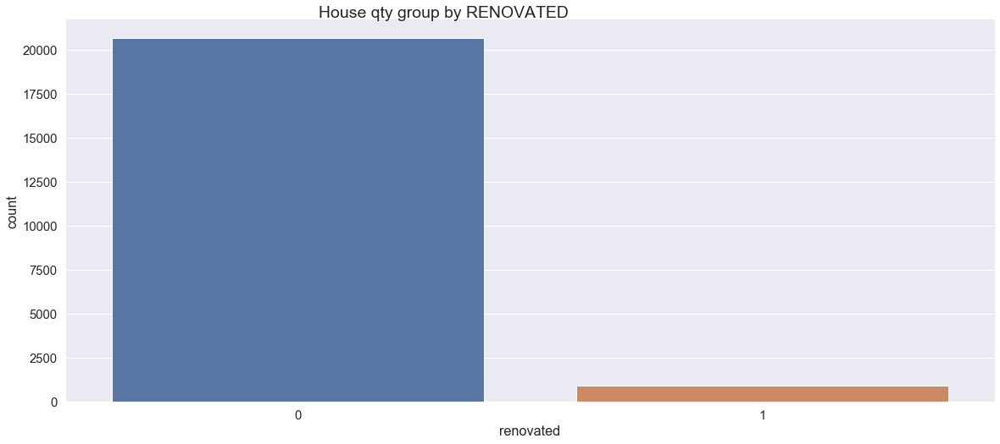

In [55]:
data['renovated'] = data['yr_renovated'].apply(lambda x: 0 if x == 0 else 1 )

g = sns.catplot(x='renovated', kind='count', data=data)
g.fig.set_size_inches(20,8)
g.fig.suptitle('House qty group by RENOVATED');

In [56]:
data['renovated'].value_counts()

0    20677
1      914
Name: renovated, dtype: int64

#### 11. lat & long and zipcode

In [57]:
geo_data = data[['id', 'lat', 'long', 'zipcode']].copy()
geo_data['zipcode'] = geo_data['zipcode'].astype(str)

fig = px.scatter_mapbox(geo_data, 
                        lat='lat', 
                        lon='long', 
                        color='zipcode',
                        zoom=10,
                        width=980,
                        height=880,
                        title='Houses group by zipcode')

fig.show()

# C2) Feature engineering

    - price/sqft_living
    - price/sqft_lot
    - sqft_total: sqft_living + sqft_lot
    - price/sqft_total
    - total_rooms: bedrooms + bathrooms
    - basement_living: does house has basement? (below ground level)
    - renovated: does house was renovated?
    - neighborhood
    - avg_neighborhood_price
    - dif between neighborhood avg
    - sqft_living/total_rooms

In [58]:
data['price/sqft_living'] = data['price'] / data['sqft_living']
data['price/sqft_lot'] = data['price'] / data['sqft_lot']

data['sqft_total'] = data['sqft_living'] + data['sqft_lot']
data['price/sqft_total'] = data['price'] / data['sqft_total']

data['total_rooms'] = data['bedrooms'] + data['bathrooms']
data['basement_living'] = data['sqft_basement'].apply(lambda x: 1 if x > 0 else 0)
data['renovated'] = data['yr_renovated'].apply(lambda x: 0 if x == 0 else 1 )

data['year'] = data['date'].apply(lambda x: x.year)
data['month'] = data['date'].apply(lambda x: x.month)
data['part-date'] = data['date'].apply(lambda x: dt.strftime(x, '%Y-%m'))

data['sqft_living/total_rooms'] =  data['sqft_living'] / data['total_rooms']

#### creating KMeans clusters for neighborhood

In [59]:
# elbow test
from yellowbrick.cluster import KElbowVisualizer
import warnings
warnings.filterwarnings('ignore') # there are warning deprecated libs modules in KElbowVisualizer


def elbow_visualize(X):
    model = KMeans()
    plt.figure(figsize=(18, 8))
    visualizer = KElbowVisualizer(model, k=(2,15))
    visualizer.fit(X)
    visualizer.show()

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:143: FutureWarning:

The sklearn.metrics.classification module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.metrics. Anything that cannot be imported from sklearn.metrics is now part of the private API.



In [60]:
geo_data = data[['lat', 'long']].copy()
kmeans_cols = ['lat', 'long']

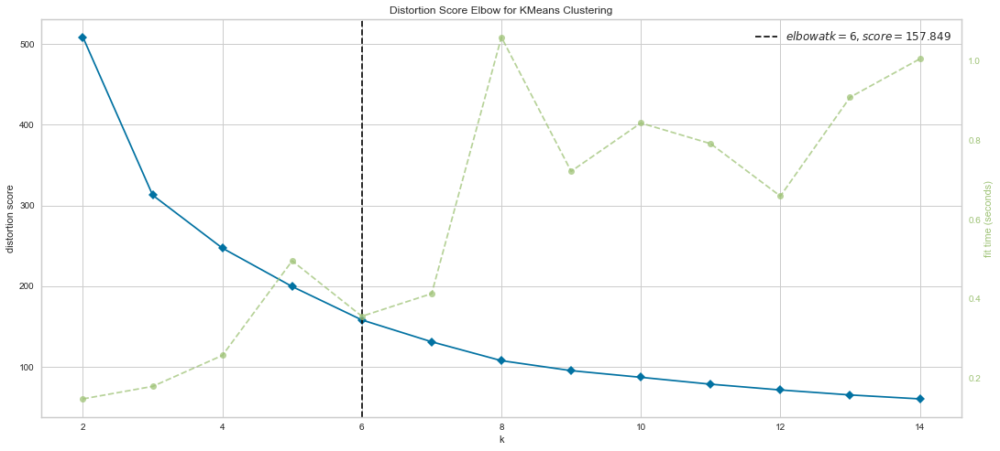

In [61]:
elbow_visualize(geo_data[kmeans_cols])

In [62]:
kmeans = KMeans(n_clusters = 9, algorithm='elkan', random_state = 2102)
kmeans.fit(geo_data[kmeans_cols])
geo_data['neighborhood'] = kmeans.predict(geo_data[kmeans_cols]).astype(str)

fig = px.scatter_mapbox(geo_data.sort_values('neighborhood'), 
                        lat='lat', 
                        lon='long', 
                        color='neighborhood',
                        zoom=10,
                        width=980,
                        height=880,
                        title='Houses group by clusters location')

fig.show()

In [63]:
data['neighborhood'] = kmeans.predict(data[kmeans_cols])

In [64]:
# setting average price per cluster
avg_cluster_price = dict(data.groupby('neighborhood')['price'].mean())
data['avg_cluster_price'] = data['neighborhood'].apply(lambda cluster: avg_cluster_price[cluster])
data['diff_price_cluster'] = data['price'] - data['avg_cluster_price']
data.groupby('neighborhood')['diff_price_cluster'].describe()

,count,mean,std,min,25%,50%,75%,max
neighborhood,,,,,,,,
0,3565.00,-0.00,257792.23,-359463.79,-154463.79,-57563.79,87536.21,3162536.21
1,2335.00,-0.00,290715.72,-577533.94,-172533.94,-46533.94,107466.06,2642466.06
2,1620.00,0.00,100933.52,-221949.49,-58949.49,-14199.49,43050.51,1193050.51
3,4959.00,0.00,375652.65,-503519.07,-213519.07,-93519.07,81480.93,7071480.93
4,1303.00,-0.00,146994.68,-257576.66,-101576.66,-35576.66,62423.34,987423.34
5,2649.00,-0.00,508686.07,-613994.77,-263994.77,-149004.77,74005.23,6358505.23
6,623.00,0.00,221361.71,-355108.67,-144108.67,-36608.67,91391.33,1508891.33
7,1692.00,-0.00,141001.03,-217626.82,-78451.82,-34126.82,32110.68,1820873.18
8,2845.00,-0.00,441276.64,-542446.30,-287946.30,-117446.30,152553.70,4667553.70


# C3) Hypotheses

    -- H1. Oldest houses have an average higher price;
> True. Oldest houses have a higher purchase price (50y +) however, this is the only exception because the average price is increased according to how new is the house.

    -- H2. Houses that were renovated are more expensive than those that haven't been renovated and built in the same year;
> True. The average price of similar houses are higher when these were renovated.

    -- H3. The waterfront has no impact on the purchase price;
> False. Houses that have waterfront are more expensive.
    
    -- H4. Houses with more sqft_living are more expensive;
> True. There are a linear correlation between house price and sqft_living
    
    -- H5. The number of bedrooms are the more important categorical feature to increase the price purchase
> False. According to cramer_v, the feature importance order that determines purchase price is: `bathroom, grade, waterfront, view, bedrooms, floors, condition`
    
    -- H6. Mountain houses have a higher price;
> False. Mountain houses are on the average price
    
    -- H7. Seattle has the highest value houses
> False. Houses prices are different according to clusters, however, the highest price location is `Union Hill & Sammamish`, after `Redmond, Woodinville & Bellevue North`. Although `Seattle North` is on top when the criterion is price/sqft_living, followed by `Redmond, Woodinville & Bellevue North`and `Union Hill & Sammamish`.
    
    -- H8. Houses with basement living space are cheaper than no underground level
> True. Even the most expensive houses having a basement living, the tendency is that houses with no below ground level living space have a higher price 
    
    -- H9. Houses with repeated ids were bought for lower prices
> False. There is a valuation in most cases, just in 6 cases of "repurchase" has devaluation (total cases of repurchase: 174).
    
    -- H10. The price of houses purchased doesn't influence by periods, like month or season.
> False. There is a greater incidence of the increase in purchase prices during spring and summer

# C4) Exploratory Data Analysis

## Hypotheses validation

### H1. Oldest houses have an average higher price

In [65]:
data_yr_bins = data.copy().query('renovated == 0')

In [66]:
cut_bins = [1899, 1964, 1984, 1999, 2009, 2015]
label_bins = ['> 50y', '30 - 50y', '15 - 30y', '5 - 15y', '< 5y']
data_yr_bins['yr_bin'] = pd.cut(data_yr_bins['yr_built'], bins=cut_bins, labels=label_bins)

In [67]:
data_yr_bins.groupby('yr_bin')['yr_built'].describe()

,count,mean,std,min,25%,50%,75%,max
yr_bin,,,,,,,,
> 50y,7815.00,1941.54,17.87,1900.00,1926.00,1947.00,1956.00,1964.00
30 - 50y,4595.00,1974.47,5.77,1965.00,1969.00,1976.00,1979.00,1984.00
15 - 30y,3512.00,1991.72,4.33,1985.00,1988.00,1991.00,1995.00,1999.00
5 - 15y,3514.00,2004.73,2.57,2000.00,2003.00,2005.00,2007.00,2009.00
< 5y,1241.00,2012.82,1.46,2010.00,2012.00,2013.00,2014.00,2015.00


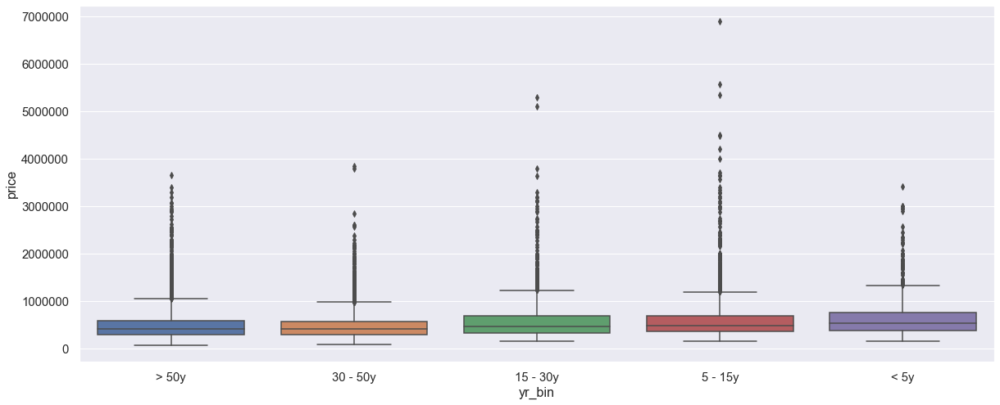

In [68]:
sns.set(figsize(20,8))
sns.set(font_scale=1.35)
sns.boxplot(x='yr_bin', y='price', data=data_yr_bins);

In [69]:
data_yr_bins.groupby('yr_bin')['price'].describe()

,count,mean,std,min,25%,50%,75%,max
yr_bin,,,,,,,,
> 50y,7815.00,493525.32,313037.68,78000.00,294000.00,425000.00,600000.00,3650000.00
30 - 50y,4595.00,476044.45,281622.37,89000.00,295000.00,415500.00,570000.00,3850000.00
15 - 30y,3512.00,565072.57,370813.37,153503.00,328875.00,475000.00,690000.00,5300000.00
5 - 15y,3514.00,613059.39,436905.21,163800.00,370000.00,496250.00,702000.00,6885000.00
< 5y,1241.00,633984.19,378626.12,155000.00,387865.00,539950.00,769995.00,3418800.00


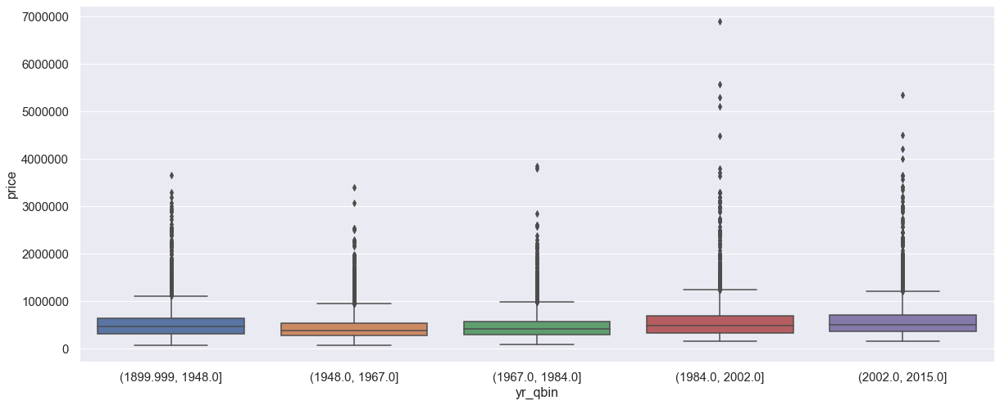

In [70]:
data_yr_bins['yr_qbin'] = pd.qcut(data_yr_bins['yr_built'], q=5)
sns.set(figsize(20,8))
sns.boxplot(x='yr_qbin', y='price', data=data_yr_bins);

In [71]:
data_yr_bins.groupby('yr_qbin')['price'].describe()

,count,mean,std,min,25%,50%,75%,max
yr_qbin,,,,,,,,
"(1899.999, 1948.0]",4173.00,527433.51,336583.74,78000.00,319450.00,462500.00,639000.00,3650000.00
"(1948.0, 1967.0]",4406.00,453639.37,274736.46,82000.00,275000.00,386950.00,545000.00,3395000.00
"(1967.0, 1984.0]",3831.00,481495.56,286320.78,89000.00,299500.00,422500.00,575000.00,3850000.00
"(1984.0, 2002.0]",4257.00,584363.89,405520.50,153503.00,337500.00,488000.00,702000.00,6885000.00
"(2002.0, 2015.0]",4010.00,607970.78,398379.62,155000.00,373125.00,499950.00,710150.00,5350000.00


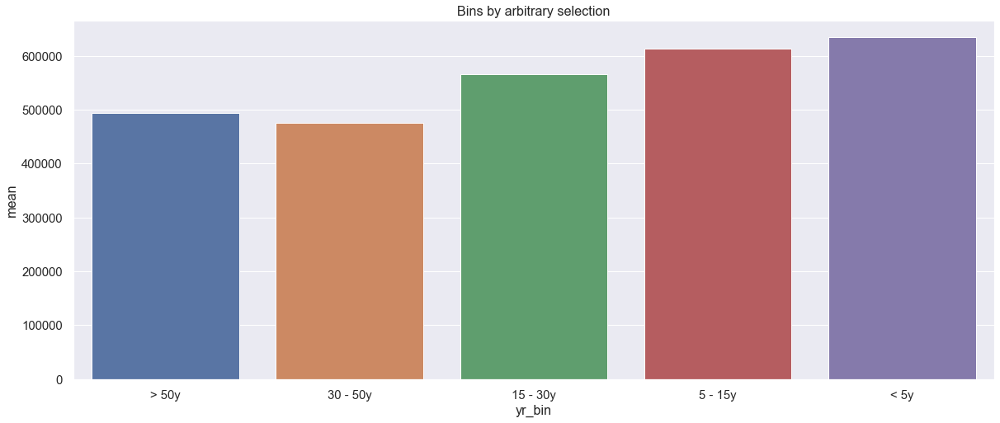

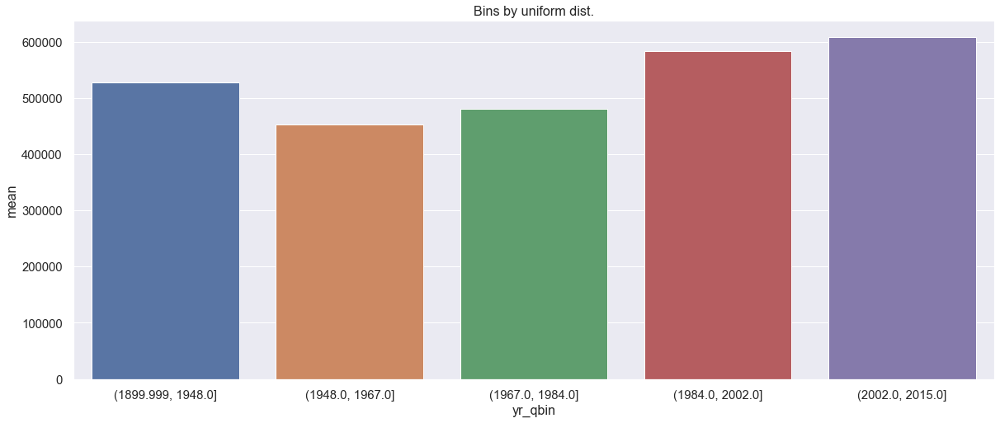

In [72]:
g = sns.barplot(x='yr_bin', y='mean', data=data_yr_bins.groupby('yr_bin')['price'].describe().reset_index());
g.set_title('Bins by arbitrary selection')
plt.show()
g = sns.barplot(x='yr_qbin', y='mean', data=data_yr_bins.groupby('yr_qbin')['price'].describe().reset_index());
g.set_title('Bins by uniform dist.');

### H2. Houses that were renovated are more expensive than those that haven't been renovated and built in the same year;

In [73]:
data_yr_bins = data.copy()
data_yr_bins['yr_qbin'] = pd.qcut(data_yr_bins['yr_built'], q=5)

In [74]:
plot_data = data_yr_bins.groupby(['yr_qbin', 'renovated'])[['price']].mean()
plot_data

price
yr_qbin            renovated          
(1899.999, 1947.0] 0         533542.05
                   1         719289.69
(1947.0, 1965.0]   0         453286.70
                   1         811194.33
(1965.0, 1983.0]   0         472087.94
                   1         826215.04
(1983.0, 2001.0]   0         583040.35
                   1         922683.33
(2001.0, 2015.0]   0         606432.10
                   1         825000.00

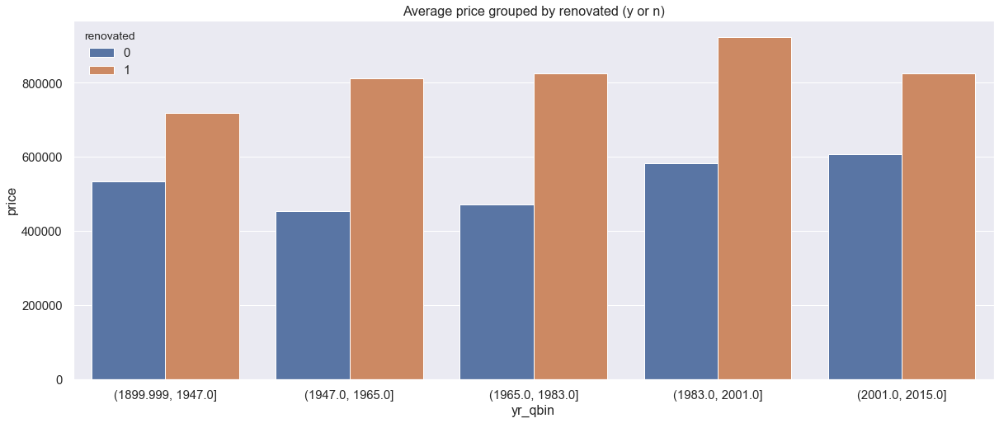

In [75]:
g = sns.barplot(data=plot_data.reset_index(), x='yr_qbin', y='price', hue='renovated');
g.set_title("Average price grouped by renovated (y or n)");

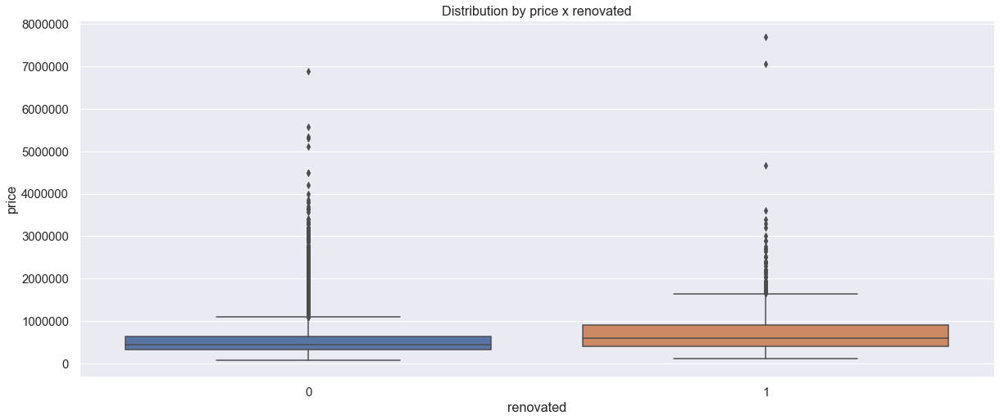

In [76]:
g = sns.boxplot(data=data_yr_bins, x='renovated', y='price');
g.set_title("Distribution by price x renovated");

In [77]:
data_yr_bins.query('renovated == 0').describe()[['price', 'bedrooms', 'bathrooms', 'sqft_living', 'view', 'condition', 'grade']].T

,count,mean,std,min,25%,50%,75%,max
price,20677.00,530537.53,349593.98,78000.00,320000.00,448175.00,635000.00,6885000.00
bedrooms,20677.00,3.37,0.90,1.00,3.00,3.00,4.00,10.00
bathrooms,20677.00,2.05,0.74,1.00,2.00,2.00,2.00,8.00
sqft_living,20677.00,2069.96,908.60,370.00,1420.00,1900.00,2530.00,13540.00
view,20677.00,0.22,0.74,0.00,0.00,0.00,0.00,4.00
condition,20677.00,3.42,0.65,1.00,3.00,3.00,4.00,5.00
grade,20677.00,7.66,1.17,4.00,7.00,7.00,8.00,13.00


In [78]:
data_yr_bins.query('renovated == 1').describe()[['price', 'bedrooms', 'bathrooms', 'sqft_living', 'view', 'condition', 'grade']].T

,count,mean,std,min,25%,50%,75%,max
price,914.00,760379.03,607734.77,110000.00,401250.00,600000.00,900000.00,7700000.00
bedrooms,914.00,3.45,1.04,1.00,3.00,3.00,4.00,11.00
bathrooms,914.00,2.31,0.90,1.00,2.00,2.00,3.00,8.00
sqft_living,914.00,2320.69,1083.82,520.00,1554.75,2200.00,2877.50,12050.00
view,914.00,0.61,1.22,0.00,0.00,0.00,0.00,4.00
condition,914.00,3.22,0.52,1.00,3.00,3.00,3.00,5.00
grade,914.00,7.74,1.21,4.00,7.00,8.00,8.00,13.00


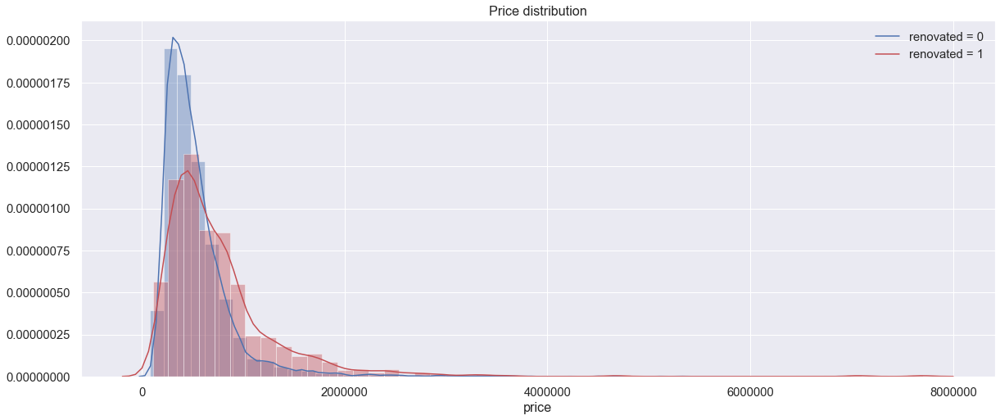

In [79]:
sns.distplot(data.query('renovated == 0')['price'], kde_kws={'label': "renovated = 0"});
g = sns.distplot(data.query('renovated == 1')['price'], color='r', kde_kws={'label': "renovated = 1"});
g.set_title("Price distribution");

### H3. The waterfront has no impact on the purchase price;

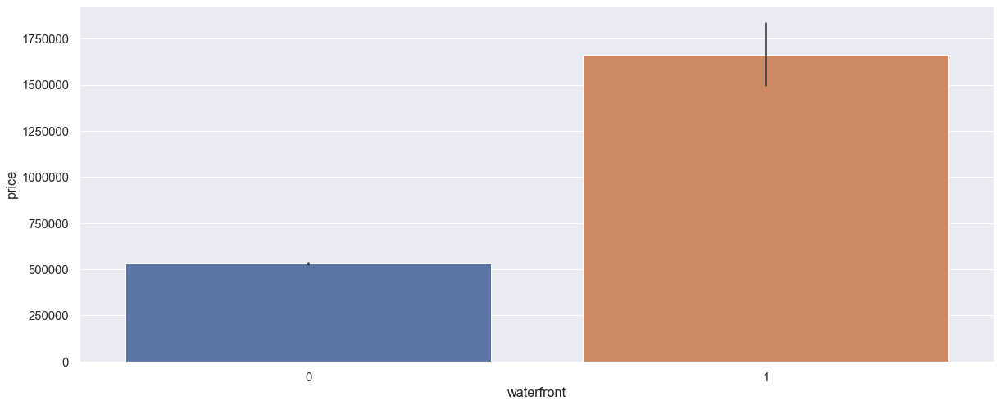

In [80]:
sns.barplot(x='waterfront', y='price', data=data);

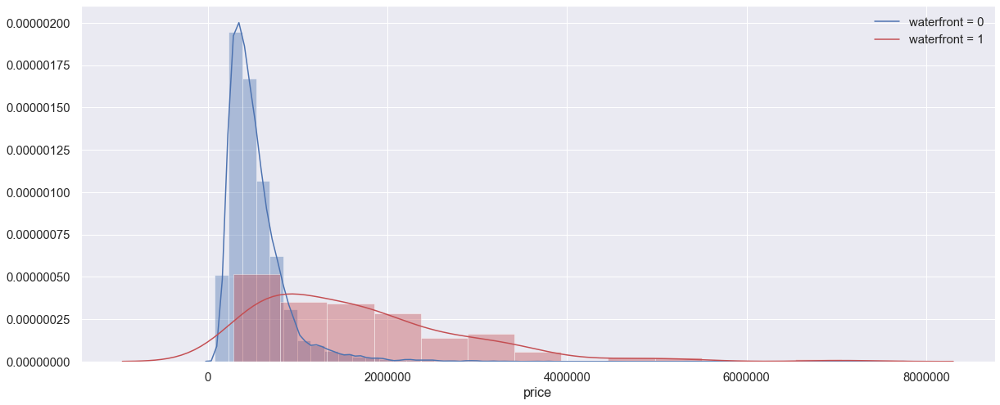

In [81]:
sns.distplot(data.query('waterfront == 0')['price'], kde_kws={'label': "waterfront = 0"});
sns.distplot(data.query('waterfront == 1')['price'], color='r', kde_kws={'label': "waterfront = 1"});

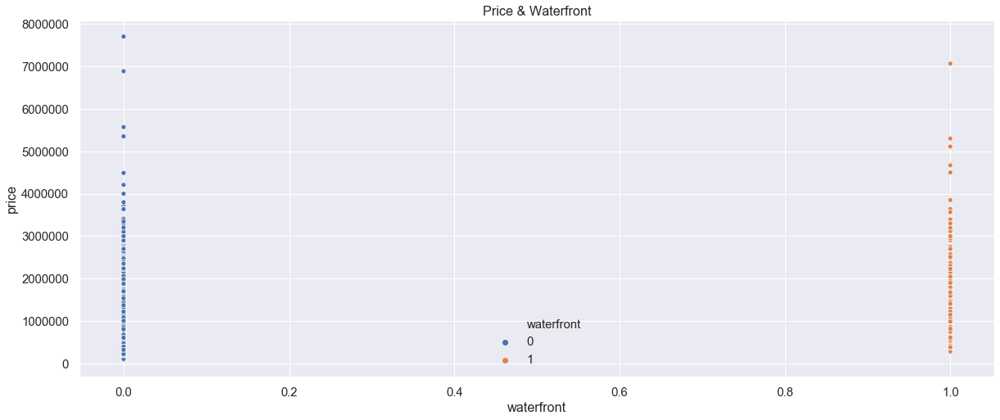

In [82]:
g = sns.scatterplot(x='waterfront', y='price', data=data, hue='waterfront');
g.set_title('Price & Waterfront');

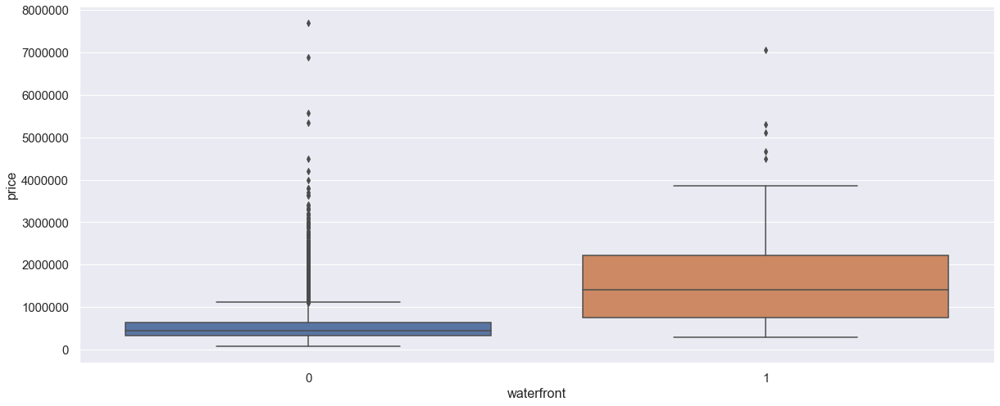

In [83]:
sns.boxplot(x='waterfront', y='price', data=data);

In [84]:
mannwhitneyu(data.query('waterfront == 0')['price'], data.query('waterfront == 1')['price'])

MannwhitneyuResult(statistic=405328.5, pvalue=1.7036189625001372e-64)

In [85]:
data.groupby('waterfront')[['price']].describe()

price                                                       \
              count       mean        std       min       25%        50%   
waterfront                                                                 
0          21428.00  531735.35  341606.47  78000.00 320000.00  450000.00   
1            163.00 1661876.02 1120371.73 285000.00 760000.00 1400000.00   

                                  
                  75%        max  
waterfront                        
0           639958.25 7700000.00  
1          2215000.00 7062500.00

In [86]:
data.query('waterfront == 0').describe()[['price', 'bedrooms', 'bathrooms', 'sqft_living', 'view', 'condition', 'grade']].T

,count,mean,std,min,25%,50%,75%,max
price,21428.00,531735.35,341606.47,78000.00,320000.00,450000.00,639958.25,7700000.00
bedrooms,21428.00,3.37,0.90,1.00,3.00,3.00,4.00,11.00
bathrooms,21428.00,2.06,0.75,1.00,2.00,2.00,2.00,8.00
sqft_living,21428.00,2072.26,905.85,370.00,1420.00,1910.00,2540.00,13540.00
view,21428.00,0.21,0.70,0.00,0.00,0.00,0.00,4.00
condition,21428.00,3.41,0.65,1.00,3.00,3.00,4.00,5.00
grade,21428.00,7.65,1.16,4.00,7.00,7.00,8.00,13.00


In [87]:
data.query('waterfront == 1').describe()[['price', 'bedrooms', 'bathrooms', 'sqft_living', 'view', 'condition', 'grade']].T

,count,mean,std,min,25%,50%,75%,max
price,163.00,1661876.02,1120371.73,285000.00,760000.00,1400000.00,2215000.00,7062500.00
bedrooms,163.00,3.30,1.08,1.00,3.00,3.00,4.00,6.00
bathrooms,163.00,2.63,1.11,1.00,2.00,2.00,3.00,7.00
sqft_living,163.00,3173.69,1606.03,440.00,2060.00,2850.00,3905.00,10040.00
view,163.00,3.77,0.56,1.00,4.00,4.00,4.00,4.00
condition,163.00,3.53,0.74,1.00,3.00,3.00,4.00,5.00
grade,163.00,8.77,1.76,5.00,8.00,9.00,10.00,12.00


### H4. Houses with more sqft_living are more expensive;

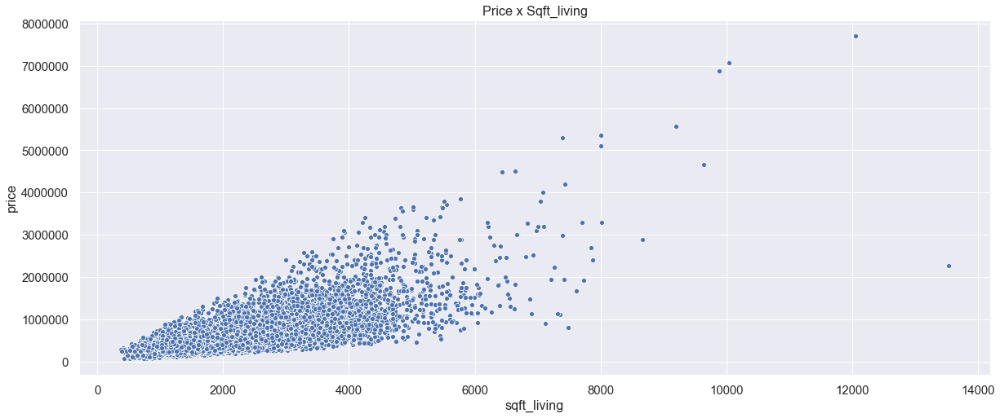

In [88]:
sns.scatterplot(x='sqft_living', y='price', data=data).set_title('Price x Sqft_living');

In [89]:
data[['price', 'sqft_living']].corr(method='pearson')

,price,sqft_living
price,1.00,0.70
sqft_living,0.70,1.00


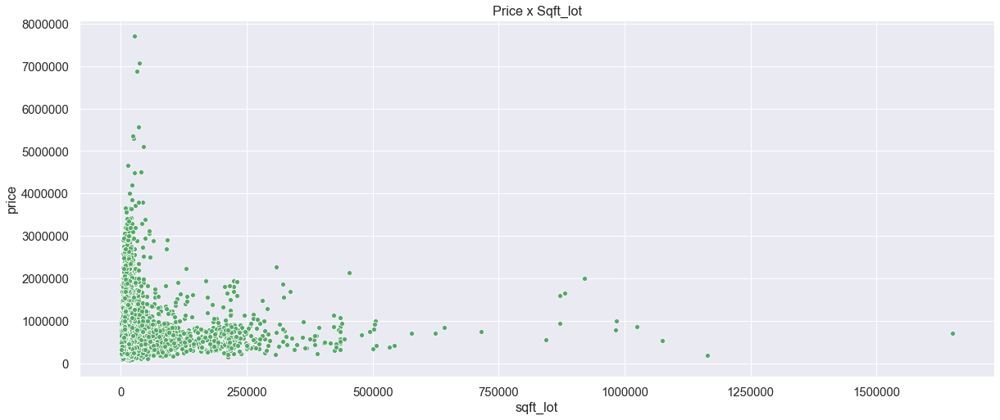

In [90]:
sns.scatterplot(x='sqft_lot', y='price', data=data, color='g').set_title('Price x Sqft_lot');

In [91]:
data[['price', 'sqft_lot']].corr(method='pearson')

,price,sqft_lot
price,1.00,0.09
sqft_lot,0.09,1.00


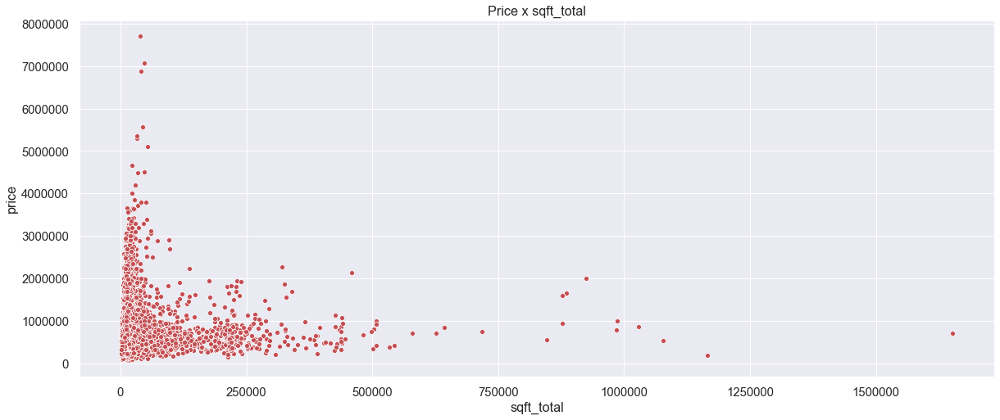

In [92]:
sns.scatterplot(x='sqft_total', y='price', data=data, color='r').set_title('Price x sqft_total');

In [93]:
data[['price', 'sqft_total']].corr(method='pearson')

,price,sqft_total
price,1.00,0.10
sqft_total,0.10,1.00


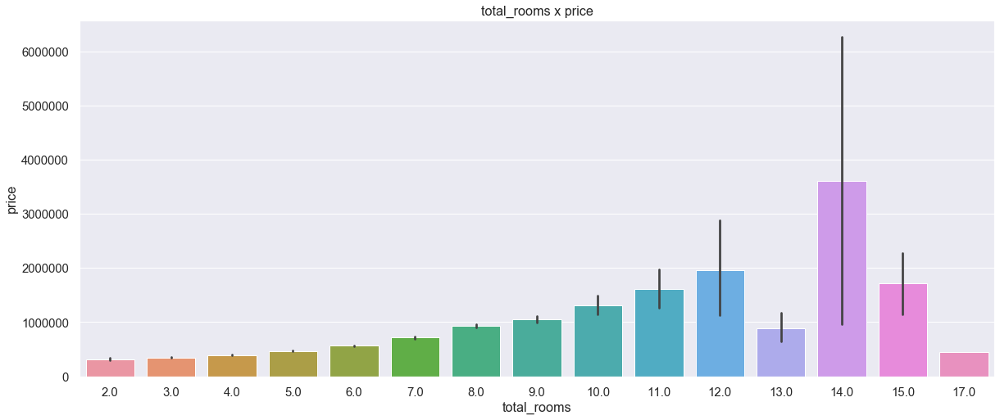

In [94]:
sns.barplot(x='total_rooms', y='price', data=data).set_title('total_rooms x price');

In [95]:
#sns.scatterplot(x='sqft_living', y='price', hue='total_rooms', data=data).set_title('Price x Sqft_living by total_rooms');
fig = px.scatter(data, x='sqft_living', y='price', color='total_rooms', title='Price x Sqft_living by total_rooms')
fig.show()

### H5. The number of bedrooms are the more important feature to increase the price purchase

In [96]:
from scipy.stats import chi2_contingency

def cramers_v(x, y):
    confusion_matrix = pd.crosstab(x,y)
    chi2 = chi2_contingency(confusion_matrix)[0]
    n = confusion_matrix.sum().sum()
    phi2 = chi2/n
    r,k = confusion_matrix.shape
    phi2corr = max(0, phi2-((k-1)*(r-1))/(n-1))
    rcorr = r-((r-1)**2)/(n-1)
    kcorr = k-((k-1)**2)/(n-1)
    return np.sqrt(phi2corr/min((kcorr-1),(rcorr-1)))

In [97]:
cols = ['bedrooms', 'bathrooms', 'floors', 'waterfront', 'view', 'view', 'condition', 'grade', 'total_rooms']

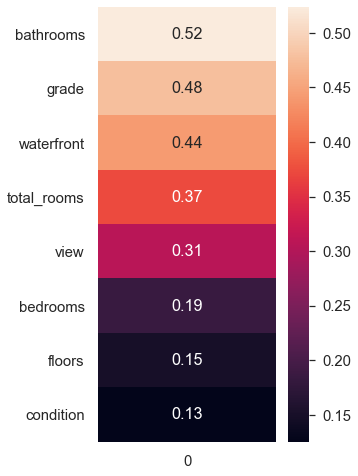

In [98]:
corr_data = {}
for col in cols:
    corr_data[col] = cramers_v(data[col], data['price'])
    
corr_data = pd.DataFrame.from_dict(corr_data, orient='index').sort_values(0, ascending=False)

plt.figure(figsize=(4,8))
sns.heatmap(corr_data, annot=True)
plt.show()

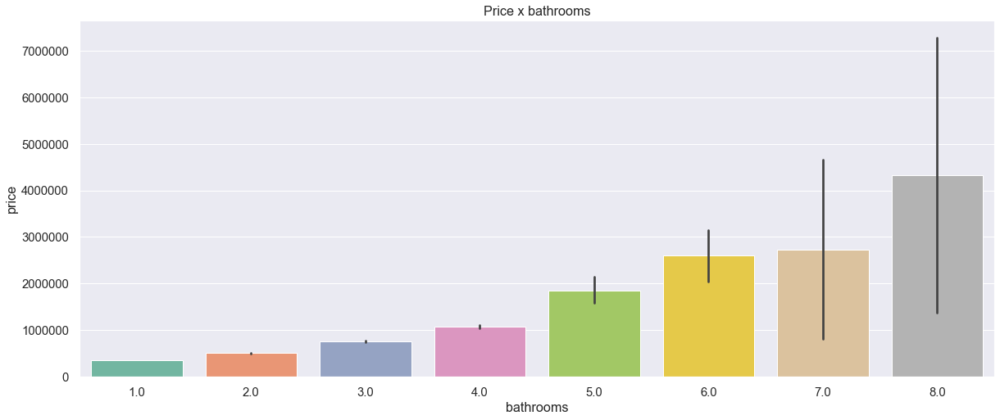

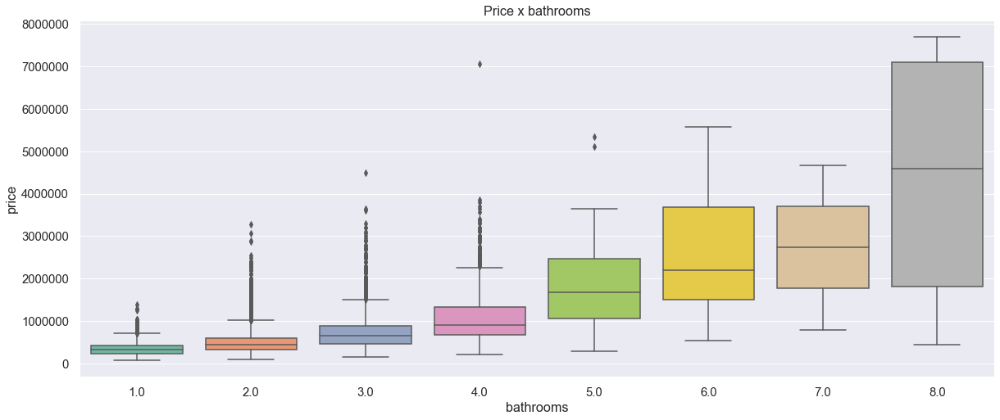

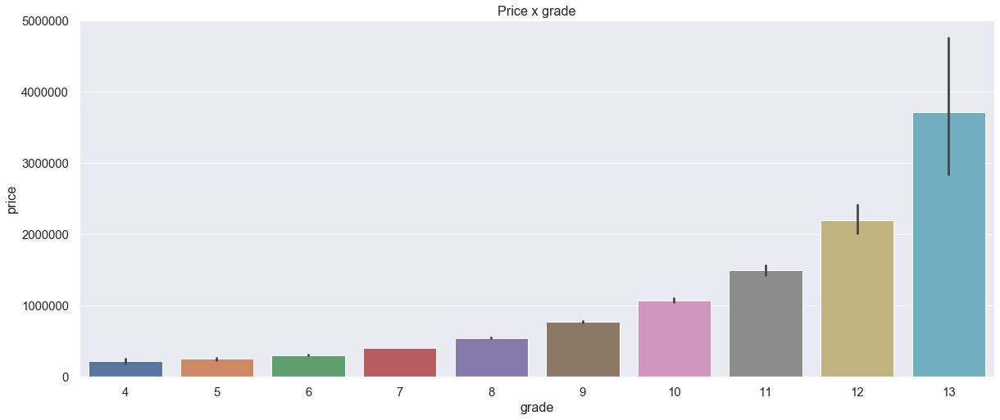

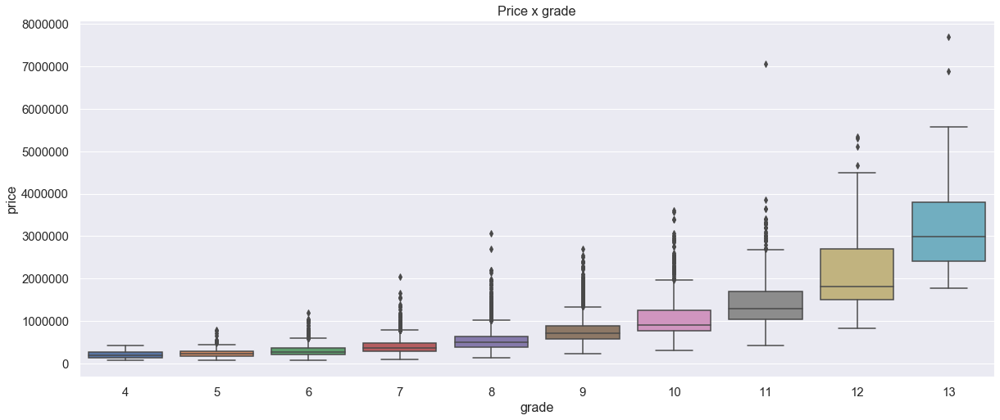

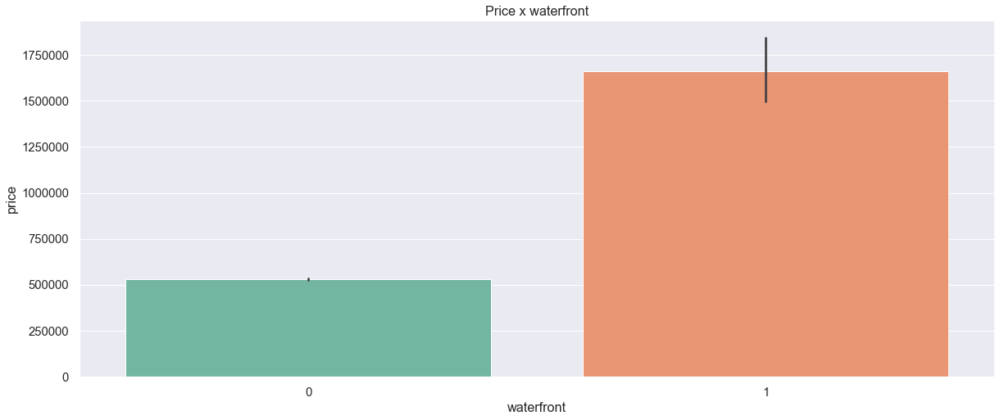

...

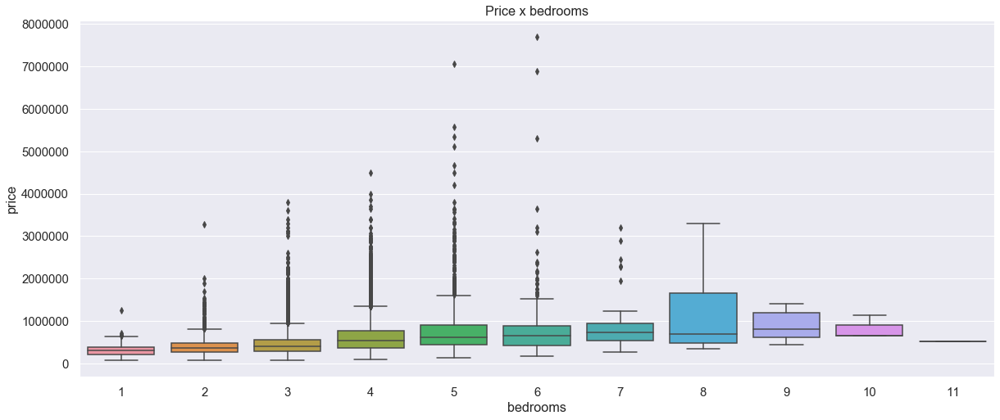

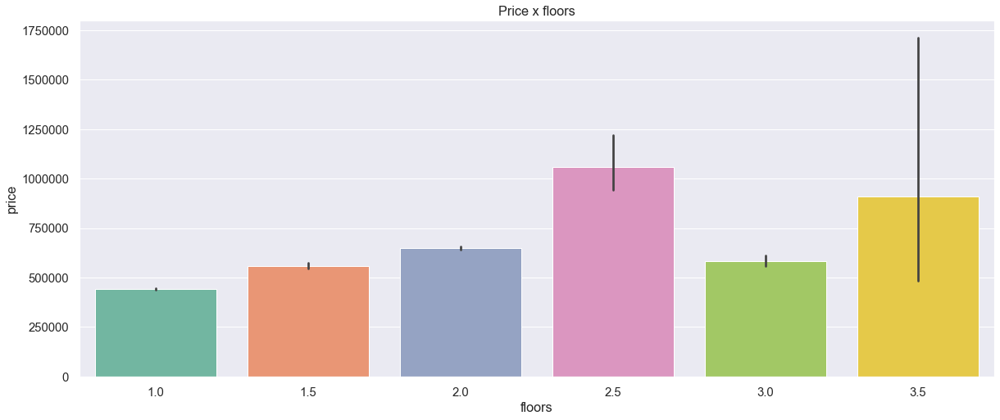

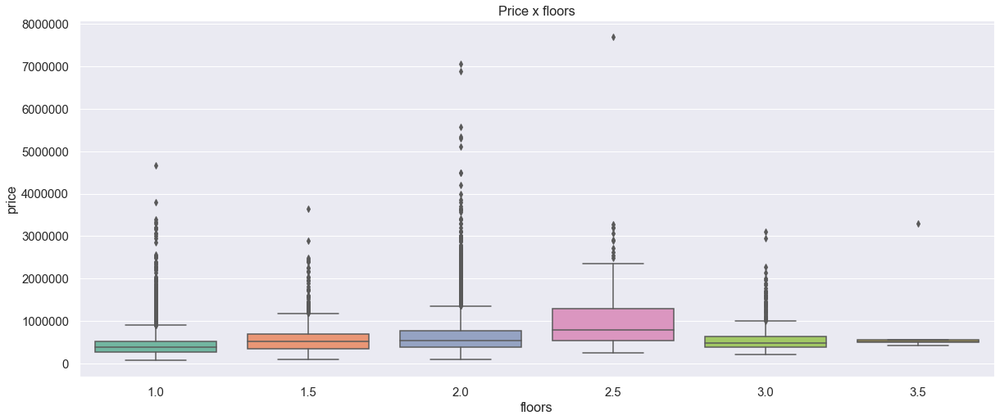

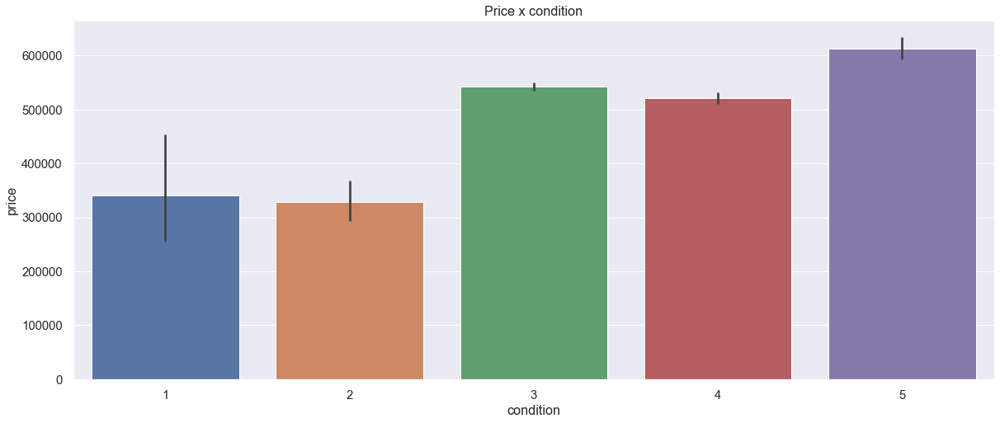

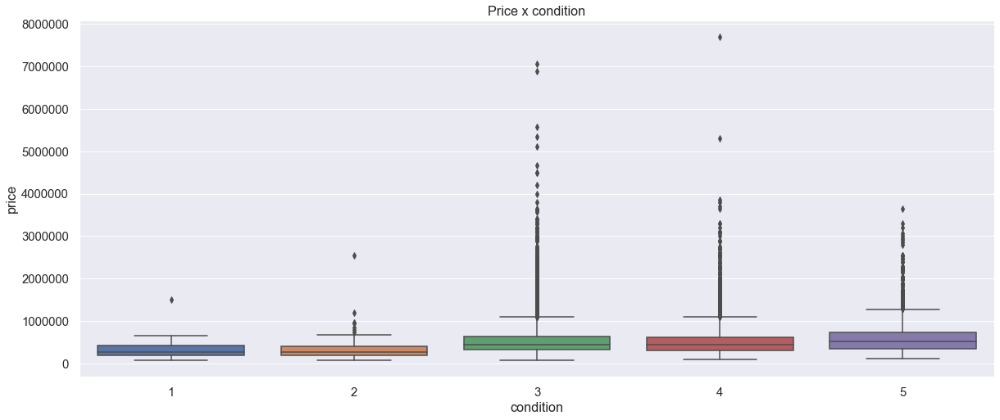

In [99]:
i = 0
for col in corr_data.index: 
    palette = 'Set2' if i % 2 == 0 else None
    sns.barplot(x=col, y='price', data=data, palette=palette).set_title(f'Price x {col}');
    plt.show()
    sns.boxplot(x=col, y='price', data=data, palette=palette).set_title(f'Price x {col}');
    plt.show()
    i += 1

### H6. Mountain houses have a higher price;
### H7. Seattle are the more expensive location to buy a house

In [159]:
geo_data = data[['id', 'lat', 'long', 'price', 'price/sqft_living', 'neighborhood']].copy()

fig = px.scatter_mapbox(geo_data, 
                        lat='lat', 
                        lon='long', 
                        color='price',
                        size='price',
                        zoom=10,
                        width=980,
                        height=880,
                        title='Houses group by price')

fig.show()

In [158]:
fig = px.scatter_mapbox(geo_data, 
                        lat='lat', 
                        lon='long', 
                        color='price/sqft_living',
                        zoom=10,
                        width=980,
                        height=880,
                        title='Houses group by price/sqft_living')

fig.show()

In [102]:
fig = px.scatter_mapbox(geo_data, 
                        lat='lat', 
                        lon='long', 
                        color='neighborhood',
                        zoom=10,
                        width=980,
                        height=880,
                        title='Houses group by price/sqft_living')

fig.show()

In [103]:
neighborhood_grouped_data = data.groupby('neighborhood')['price'].describe()
neighborhood_grouped_data['cluster_name'] = ['Seattle South', 'Union Hill & Sammamish', 'Kent & North Auburn', 'Seattle North',
                                            'Maple Valley', 'Redmond, Woodinville & Bellevue North', 'Preston', 'Des Moines & Federal Way', 'Mercer Island, Renton & Bellevue South' ]

neighborhood_grouped_data.sort_values(['50%'], ascending=False)

,count,mean,std,min,25%,50%,75%,max,cluster_name
neighborhood,,,,,,,,,
1,2335.00,657533.94,290715.72,80000.00,485000.00,611000.00,765000.00,3300000.00,Union Hill & Sammamish
5,2649.00,703994.77,508686.07,90000.00,440000.00,554990.00,778000.00,7062500.00,"Redmond, Woodinville & Bellevue North"
3,4959.00,628519.07,375652.65,125000.00,415000.00,535000.00,710000.00,7700000.00,Seattle North
8,2845.00,632446.30,441276.64,90000.00,344500.00,515000.00,785000.00,5300000.00,"Mercer Island, Renton & Bellevue South"
6,623.00,489108.67,221361.71,134000.00,345000.00,452500.00,580500.00,1998000.00,Preston
0,3565.00,437463.79,257792.23,78000.00,283000.00,379900.00,525000.00,3600000.00,Seattle South
4,1303.00,362576.66,146994.68,105000.00,261000.00,327000.00,425000.00,1350000.00,Maple Valley
2,1620.00,306949.49,100933.52,85000.00,248000.00,292750.00,350000.00,1500000.00,Kent & North Auburn
7,1692.00,304126.82,141001.03,86500.00,225675.00,270000.00,336237.50,2125000.00,Des Moines & Federal Way


In [104]:
neighborhood_grouped_sqft_price = data.groupby('neighborhood')['price/sqft_living'].describe()
neighborhood_grouped_sqft_price['cluster_name'] = ['Seattle South', 'Union Hill & Sammamish', 'Kent & North Auburn', 'Seattle North',
                                            'Maple Valley', 'Redmond, Woodinville & Bellevue North', 'Preston', 'Des Moines & Federal Way', 'Mercer Island, Renton & Bellevue South' ]

neighborhood_grouped_sqft_price.sort_values(['50%'], ascending=False)

,count,mean,std,min,25%,50%,75%,max,cluster_name
neighborhood,,,,,,,,,
3,4959.00,344.75,110.95,100.00,264.71,332.39,405.92,810.14,Seattle North
5,2649.00,296.83,110.01,90.75,228.44,268.40,325.64,792.11,"Redmond, Woodinville & Bellevue North"
1,2335.00,262.92,63.94,100.00,227.96,256.40,288.94,800.00,Union Hill & Sammamish
0,3565.00,266.46,102.51,87.65,189.76,251.41,325.55,792.68,Seattle South
8,2845.00,259.72,99.93,87.71,186.22,242.02,308.17,790.82,"Mercer Island, Renton & Bellevue South"
6,623.00,218.16,52.43,106.41,188.07,208.89,238.90,643.35,Preston
4,1303.00,179.40,49.38,88.00,151.34,172.44,196.02,674.58,Maple Valley
7,1692.00,163.67,51.79,88.15,132.88,154.78,181.34,791.67,Des Moines & Federal Way
2,1620.00,158.72,37.21,87.59,136.95,153.52,174.32,585.77,Kent & North Auburn


### H8. Houses with basement living space are cheaper than no underground level

In [105]:
basement_living_price = data.groupby(['neighborhood', 'basement_living'])[['price/sqft_living']].median().reset_index()
basement_living_price

,neighborhood,basement_living,price/sqft_living
0,0,0,263.78
1,0,1,244.40
2,1,0,258.06
3,1,1,248.33
4,2,0,156.11
5,2,1,144.88
6,3,0,347.22
7,3,1,321.30
8,4,0,173.42
9,4,1,165.43


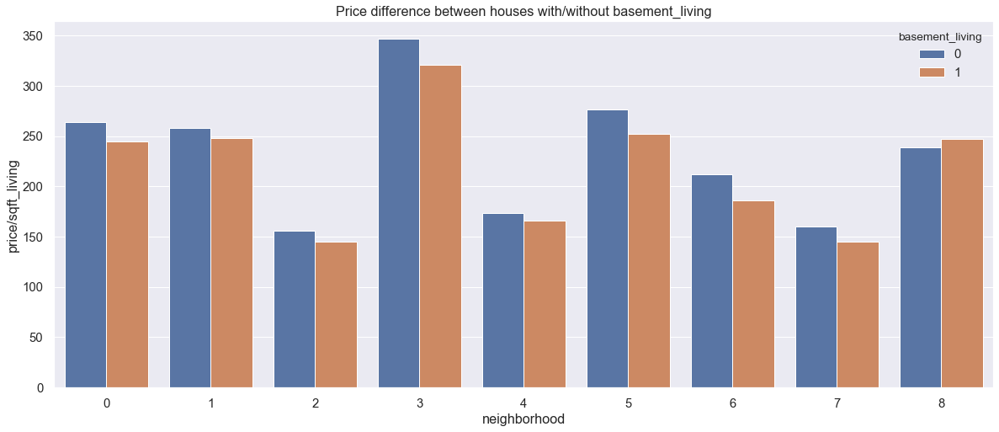

In [106]:
sns.barplot(x='neighborhood', y='price/sqft_living', hue='basement_living', data = basement_living_price).set_title('Price difference between houses with/without basement_living');

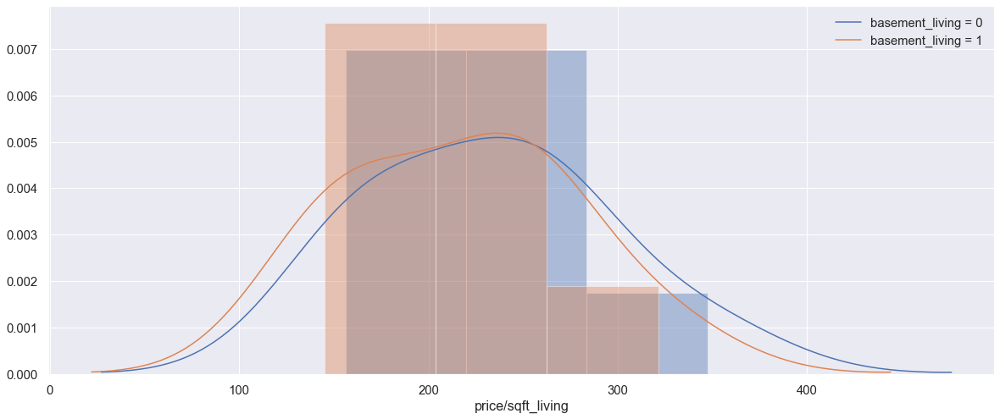

In [107]:
sns.distplot(basement_living_price.query('basement_living == 0')['price/sqft_living'], kde_kws={'label': 'basement_living = 0'})
sns.distplot(basement_living_price.query('basement_living == 1')['price/sqft_living'], kde_kws={'label': 'basement_living = 1'});

In [108]:
data.groupby(['basement_living'])[['price/sqft_living']].describe()

price/sqft_living                                           \
                            count   mean    std   min    25%    50%    75%   
basement_living                                                              
0                        13107.00 262.05 111.60 87.59 180.14 240.20 311.30   
1                         8484.00 267.29 107.29 88.03 186.81 252.05 327.32   

                        
                   max  
basement_living         
0               810.14  
1               798.12

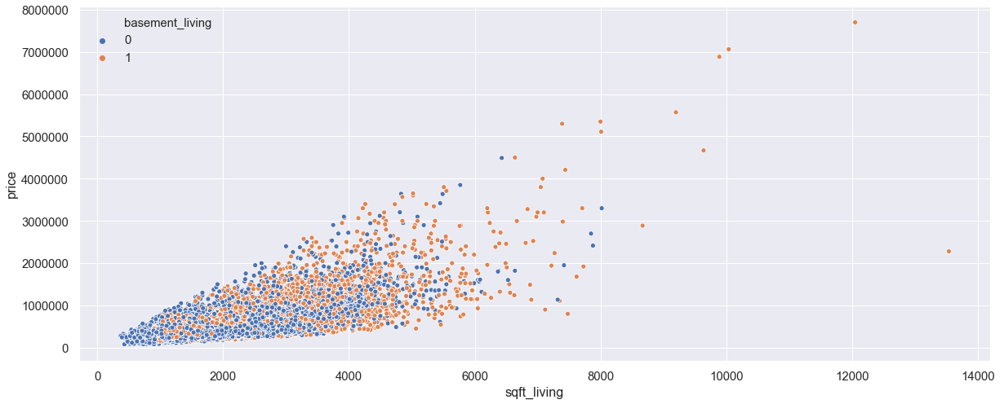

In [109]:
sns.scatterplot(x='sqft_living', y='price', hue='basement_living', data=data);

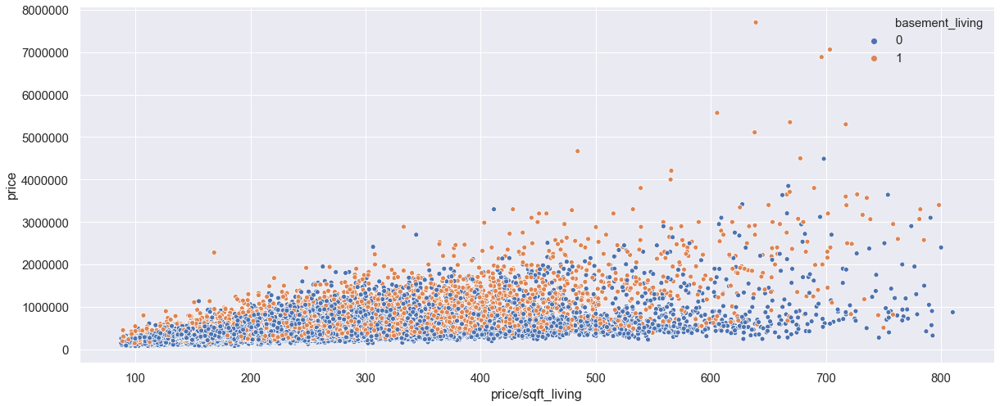

In [110]:
sns.scatterplot(x='price/sqft_living', y='price', hue='basement_living', data=data);

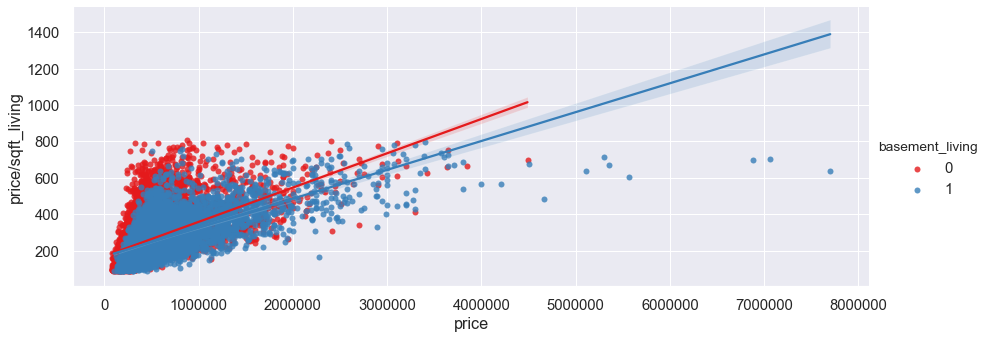

In [111]:
#plt.figure(size=7)
sns.lmplot(x='price', y='price/sqft_living', hue='basement_living', data=data,  palette='Set1', height=5, aspect=2.5);
plt.show()

### H9. There is a devaluation for houses that have been sold more than once

In [112]:
def set_cluster_label(l):
    labels = ['Seattle South', 'Union Hill & Sammamish', 'Kent & North Auburn', 'Seattle North', 'Maple Valley', 
            'Redmond, Woodinville & Bellevue North', 'Preston', 'Des Moines & Federal Way', 
            'Mercer Island, Renton & Bellevue South']
    return labels[l]
    
data['neighborhood_name'] = data['neighborhood'].apply(set_cluster_label)

In [113]:
# getting duplicated
idx_duplicated = data.groupby('id').count().query('date >= 2').index

resold = data.loc[idx_duplicated].sort_values(['id', 'date'], ascending=True)
resold.head(10)

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,year,yr_built_yr_sale_dif,renovated,price/sqft_living,price/sqft_lot,sqft_total,price/sqft_total,total_rooms,basement_living,month,part-date,sqft_living/total_rooms,neighborhood,avg_cluster_price,diff_price_cluster,neighborhood_name
1000102,1000102,2014-09-16,280000.00,6,3.00,2400,9373,2.00,0,0,3,7,2400,0,1991,0,98002,47.33,-122.21,2060,7316,2014,23,0,116.67,29.87,11773,23.78,9.00,0,9,2014-09,266.67,2,306949.49,-26949.49,Kent & North Auburn
1000102,1000102,2015-04-22,300000.00,6,3.00,2400,9373,2.00,0,0,3,7,2400,0,1991,0,98002,47.33,-122.21,2060,7316,2015,24,0,125.00,32.01,11773,25.48,9.00,0,4,2015-04,266.67,2,306949.49,-6949.49,Kent & North Auburn
7200179,7200179,2014-10-16,150000.00,2,1.00,840,12750,1.00,0,0,3,6,840,0,1925,0,98055,47.48,-122.21,1480,6969,2014,89,0,178.57,11.76,13590,11.04,3.00,0,10,2014-10,280.00,8,632446.30,-482446.30,"Mercer Island, Renton & Bellevue South"
7200179,7200179,2015-04-24,175000.00,2,1.00,840,12750,1.00,0,0,3,6,840,0,1925,0,98055,47.48,-122.21,1480,6969,2015,90,0,208.33,13.73,13590,12.88,3.00,0,4,2015-04,280.00,8,632446.30,-457446.30,"Mercer Island, Renton & Bellevue South"
109200390,109200390,2014-08-20,245000.00,3,2.00,1480,3900,1.00,0,0,4,7,1480,0,1980,0,98023,47.30,-122.37,1830,6956,2014,34,0,165.54,62.82,5380,45.54,5.00,0,8,2014-08,296.00,7,304126.82,-59126.82,Des Moines & Federal Way
109200390,109200390,2014-10-20,250000.00,3,2.00,1480,3900,1.00,0,0,4,7,1480,0,1980,0,98023,47.30,-122.37,1830,6956,2014,34,0,168.92,64.10,5380,46.47,5.00,0,10,2014-10,296.00,7,304126.82,-54126.82,Des Moines & Federal Way
123039336,123039336,2014-06-11,148000.00,1,1.00,620,8261,1.00,0,0,3,5,620,0,1939,0,98106,47.51,-122.36,1180,8244,2014,75,0,238.71,17.92,8881,16.66,2.00,0,6,2014-06,310.00,0,437463.79,-289463.79,Seattle South
123039336,123039336,2014-12-08,244900.00,1,1.00,620,8261,1.00,0,0,3,5,620,0,1939,0,98106,47.51,-122.36,1180,8244,2014,75,0,395.00,29.65,8881,27.58,2.00,0,12,2014-12,310.00,0,437463.79,-192563.79,Seattle South
251300110,251300110,2014-07-31,225000.00,3,2.00,2510,12013,2.00,0,0,3,8,2510,0,1988,0,98003,47.35,-122.31,1870,8017,2014,26,0,89.64,18.73,14523,15.49,5.00,0,7,2014-07,502.00,7,304126.82,-79126.82,Des Moines & Federal Way
251300110,251300110,2015-01-14,358000.00,3,2.00,2510,12013,2.00,0,0,3,8,2510,0,1988,0,98003,47.35,-122.31,1870,8017,2015,27,0,142.63,29.80,14523,24.65,5.00,0,1,2015-01,502.00,7,304126.82,53873.18,Des Moines & Federal Way


In [114]:
# was there changes that could change the price?
print(resold['id'].nunique())

resold.groupby(['id', 'bedrooms', 'bathrooms', 'floors', 
                  'waterfront', 'view', 'condition', 'grade', 'sqft_living', 'renovated']).count().shape

176


(176, 27)

In [115]:
# calculating difference between purchases periods
resold['valuation'] = np.where(resold['id'] == resold['id'].shift(), resold['price'] - resold['price'].shift(), 0)
resold[['id', 'date', 'price', 'valuation']].head(10)

,id,date,price,valuation
1000102,1000102,2014-09-16,280000.00,0.00
1000102,1000102,2015-04-22,300000.00,20000.00
7200179,7200179,2014-10-16,150000.00,0.00
7200179,7200179,2015-04-24,175000.00,25000.00
109200390,109200390,2014-08-20,245000.00,0.00
109200390,109200390,2014-10-20,250000.00,5000.00
123039336,123039336,2014-06-11,148000.00,0.00
123039336,123039336,2014-12-08,244900.00,96900.00
251300110,251300110,2014-07-31,225000.00,0.00
251300110,251300110,2015-01-14,358000.00,133000.00


In [116]:
resold.query('valuation < 0')

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,year,yr_built_yr_sale_dif,renovated,price/sqft_living,price/sqft_lot,sqft_total,price/sqft_total,total_rooms,basement_living,month,part-date,sqft_living/total_rooms,neighborhood,avg_cluster_price,diff_price_cluster,neighborhood_name,valuation
2619920170,2619920170,2014-12-19,765000.00,4,2.00,3230,4290,2.00,0,0,3,9,3230,0,2004,0,98033,47.69,-122.16,3220,5083,2014,10,0,236.84,178.32,7520,101.73,6.00,0,12,2014-12,538.33,5,703994.77,61005.23,"Redmond, Woodinville & Bellevue North",-7500.00
2726049071,2726049071,2015-04-08,489950.00,2,1.00,820,4206,1.00,0,0,3,5,820,0,1949,0,98125,47.71,-122.28,1810,7200,2015,66,0,597.50,116.49,5026,97.48,3.00,0,4,2015-04,273.33,3,628519.07,-138569.07,Seattle North,-20050.00
2767603612,2767603612,2015-01-13,489000.00,2,2.00,1290,1334,3.00,0,0,3,8,1290,0,2007,0,98107,47.67,-122.38,1350,1334,2015,8,0,379.07,366.57,2624,186.36,4.00,0,1,2015-01,322.50,3,628519.07,-139519.07,Seattle North,-11000.00
4139420590,4139420590,2014-08-27,1200000.00,4,4.00,4560,16643,1.00,0,3,3,12,2230,2330,1995,0,98006,47.55,-122.11,4060,15177,2014,19,0,263.16,72.10,21203,56.60,8.00,1,8,2014-08,570.00,8,632446.30,567553.70,"Mercer Island, Renton & Bellevue South",-12500.00
7167000040,7167000040,2015-03-05,700000.00,4,3.00,3350,199253,2.00,0,0,3,10,3350,0,2004,0,98010,47.36,-121.99,3350,183897,2015,11,0,208.96,3.51,202603,3.46,7.00,0,3,2015-03,478.57,4,362576.66,337423.34,Maple Valley,-40000.00
8682262400,8682262400,2015-05-13,419950.00,2,2.00,1350,4003,1.00,0,0,3,8,1350,0,2004,0,98053,47.72,-122.03,1350,4479,2015,11,0,311.07,104.91,5353,78.45,4.00,0,5,2015-05,337.50,1,657533.94,-237583.94,Union Hill & Sammamish,-10050.00


In [117]:
resold.query('valuation < 0').shape

(6, 38)

In [118]:
resold.query('valuation > 0').shape

(168, 38)

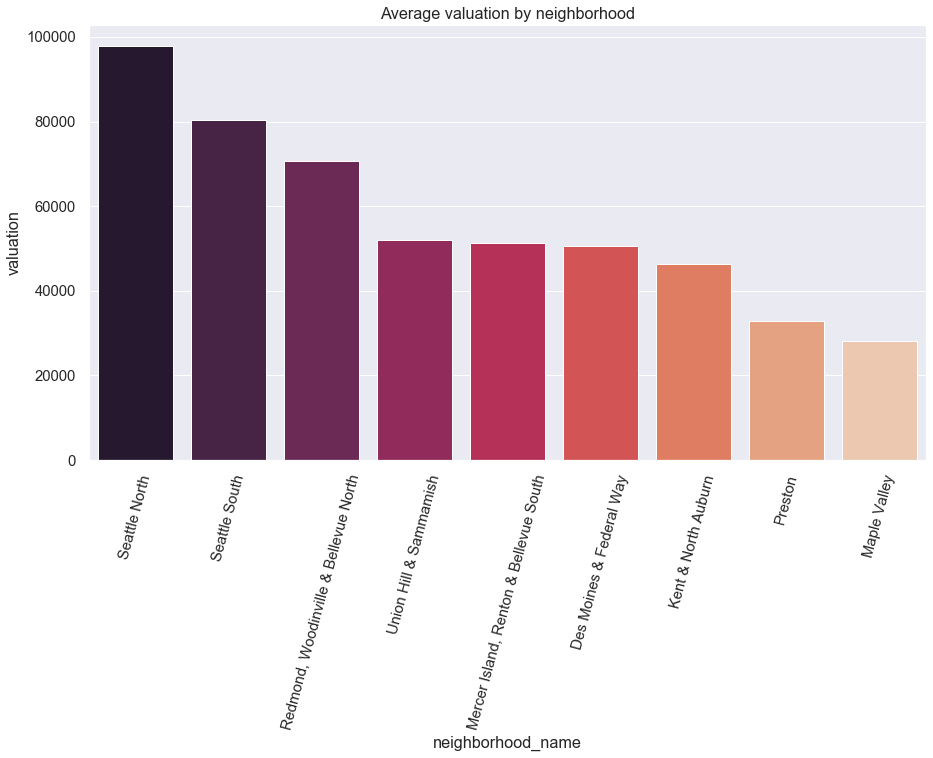

In [119]:
# valuation cumulated by neighborhood cluster
sns.set(figsize(15, 8))
sns.set(font_scale=1.35)
plot_data = resold.groupby('neighborhood_name')[['valuation']].mean().reset_index()

g = sns.barplot(x='neighborhood_name', 
                y='valuation', 
                data=plot_data, 
                order=plot_data.sort_values('valuation',ascending = False).neighborhood_name,
                palette='rocket'
               )

g.set_xticklabels(g.get_xticklabels(), rotation=75)
g.set_title("Average valuation by neighborhood");

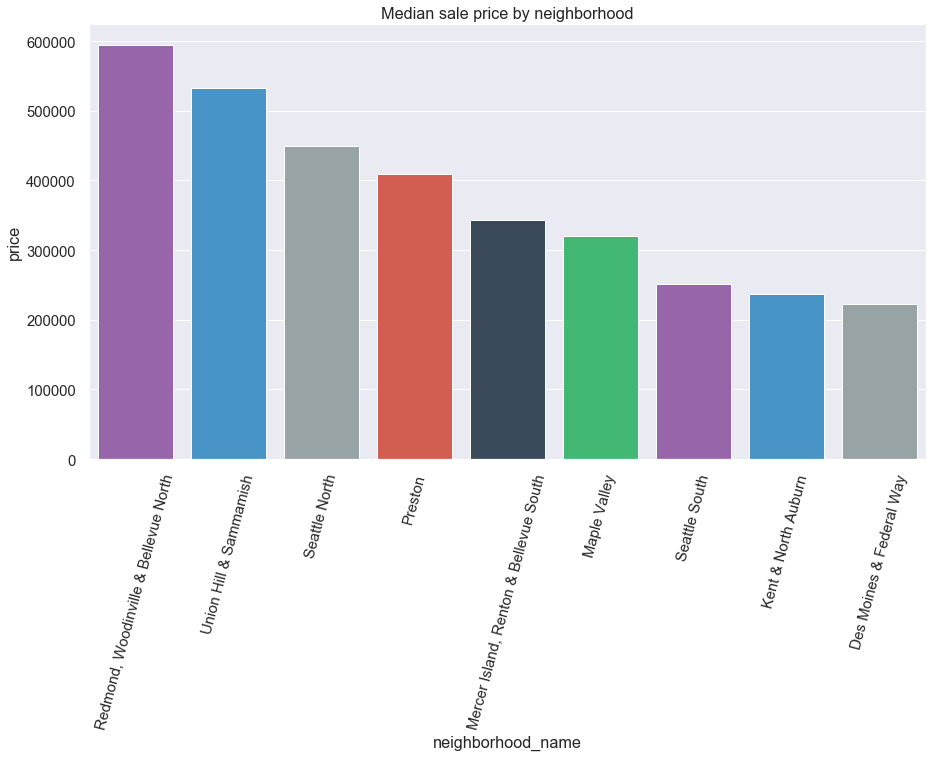

In [181]:
sns.set(figsize(15, 8))
sns.set(font_scale=1.35)
plot_data = resold.groupby('neighborhood_name')['price'].median().reset_index()
g = sns.barplot(x='neighborhood_name', 
                y='price',
                data=plot_data,
                order=plot_data.sort_values('price', ascending = False).neighborhood_name,
                palette=palette)
g.set_xticklabels(g.get_xticklabels(), rotation=75)
g.set_title("Median sale price by neighborhood");

In [120]:
resold['valuation_%'] = resold['valuation'] / resold['price']
resold[['price', 'valuation','valuation_%']]

,price,valuation,valuation_%
1000102,280000.00,0.00,0.00
1000102,300000.00,20000.00,0.07
7200179,150000.00,0.00,0.00
7200179,175000.00,25000.00,0.14
109200390,245000.00,0.00,0.00
...,...,...,...
9828200460,430000.00,170000.00,0.40
9834200305,350000.00,0.00,0.00
9834200305,615000.00,265000.00,0.43
9834200885,360000.00,0.00,0.00


In [121]:
resold['first_purchase'] = resold['valuation'].apply(lambda x: 1 if x == 0 else 0)

first_purchase_sum = resold.query('first_purchase == 1').groupby('neighborhood_name')[['price']].sum()
valuation_sum = resold.groupby('neighborhood_name')[['valuation']].sum()

In [122]:
valuation_df = first_purchase_sum.join(valuation_sum)
valuation_df['valuation_perc'] = valuation_df['valuation'] / valuation_df['price'] * 100
valuation_df = valuation_df.reset_index()
valuation_df

,neighborhood_name,price,valuation,valuation_perc
0,Des Moines & Federal Way,3580625.00,2119772.00,59.20
1,Kent & North Auburn,2114450.00,1021400.00,48.31
2,Maple Valley,1702825.00,282125.00,16.57
3,"Mercer Island, Renton & Bellevue South",13865425.00,2977446.00,21.47
4,Preston,2369356.00,395144.00,16.68
5,"Redmond, Woodinville & Bellevue North",7108740.00,1556110.00,21.89
6,Seattle North,16116111.00,8024789.00,49.79
7,Seattle South,8268250.00,6190690.00,74.87
8,Union Hill & Sammamish,8556625.00,1455325.00,17.01


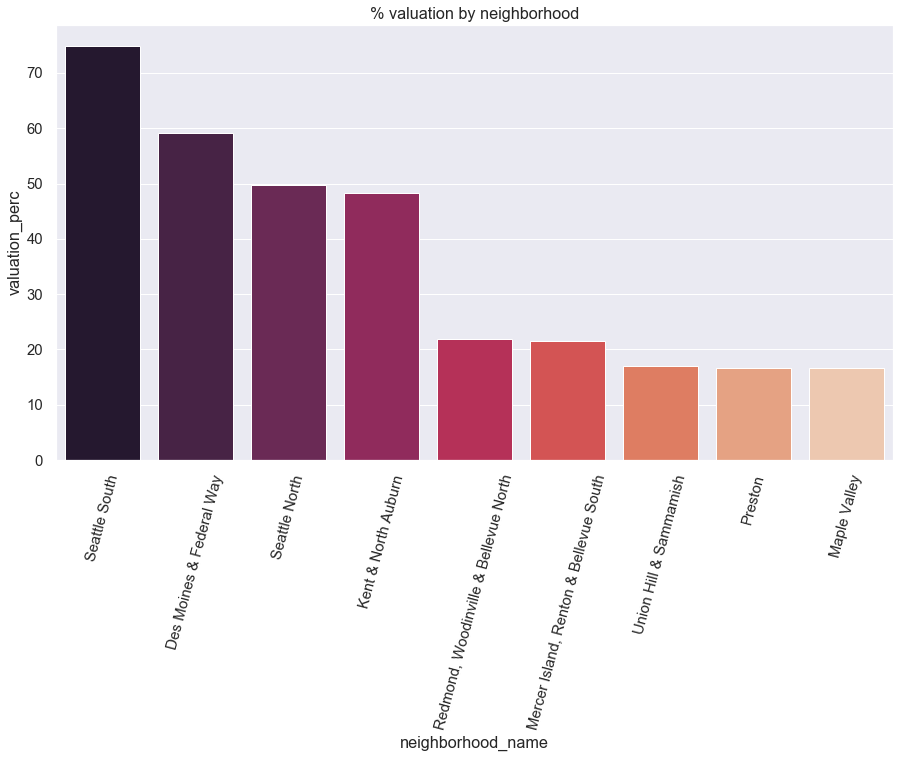

In [123]:
# valuation cumulated by neighborhood cluster
sns.set(figsize(15, 8))
sns.set(font_scale=1.35)

g = sns.barplot(x='neighborhood_name', 
                y='valuation_perc', 
                data=valuation_df, 
                order=valuation_df.sort_values('valuation_perc',ascending = False).neighborhood_name,
                palette='rocket'
               )

g.set_xticklabels(g.get_xticklabels(), rotation=75)
g.set_title("% valuation by neighborhood");

### H10. The price of houses purchased doesn't are influenced by periods, such as month or season.

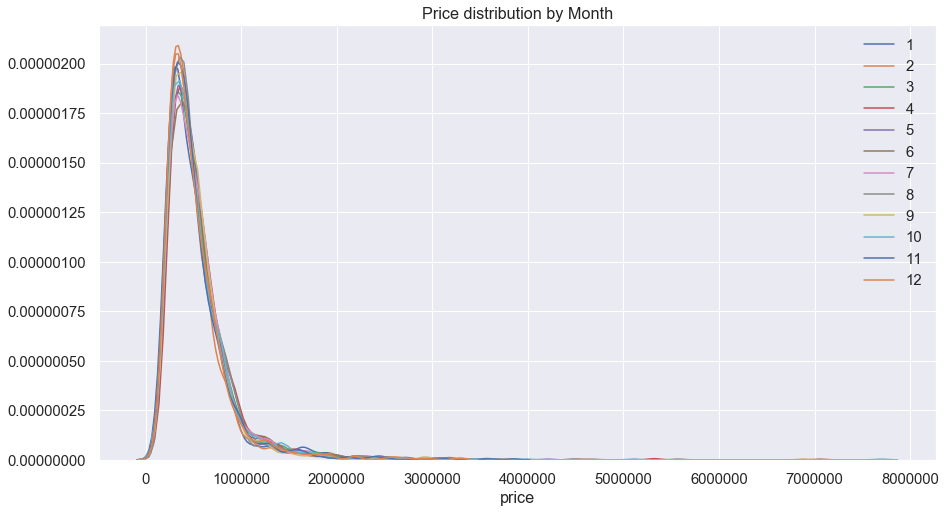

In [124]:
for month in range(1, 13):
    g = sns.distplot(data.query(f'month == {month}')['price'], hist=False, kde_kws={'label': month})
    g.set_title('Price distribution by Month')

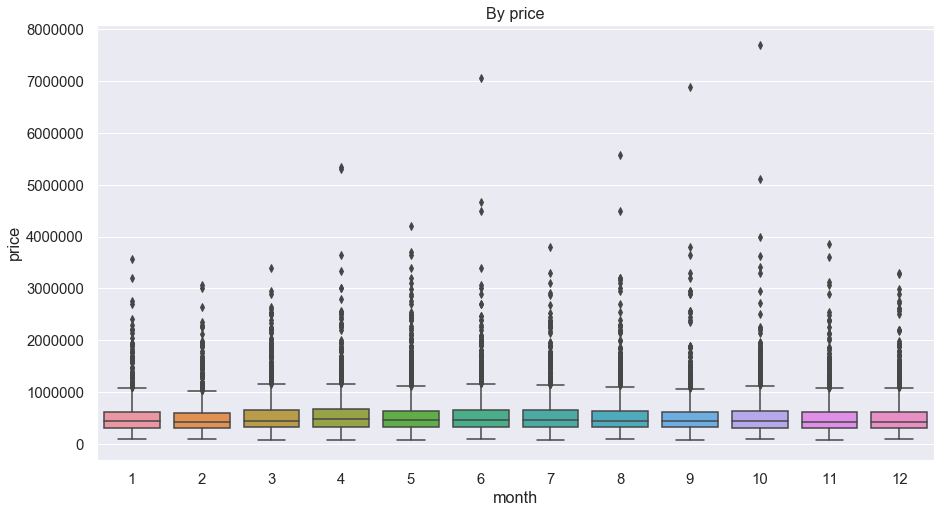

In [125]:
sns.boxplot(x='month', y='price',data=data).set_title('By price');

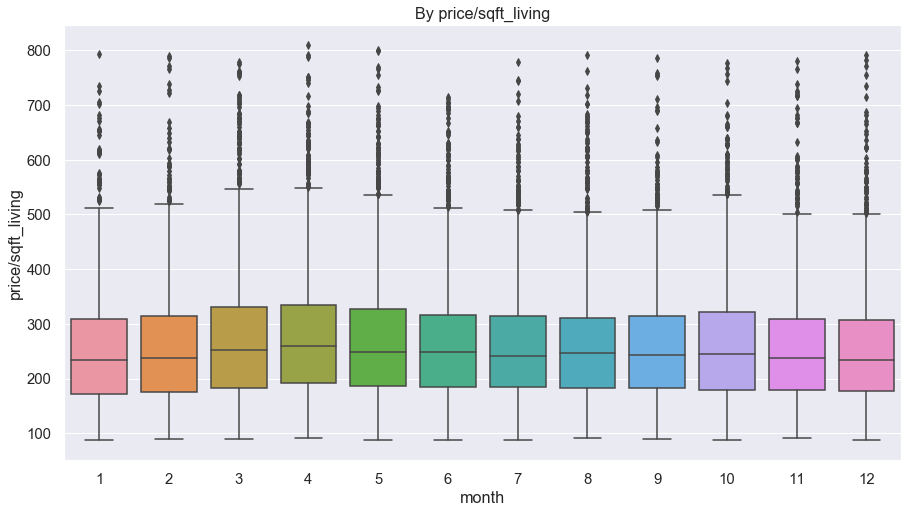

In [126]:
sns.boxplot(x='month', y='price/sqft_living',data=data).set_title('By price/sqft_living');

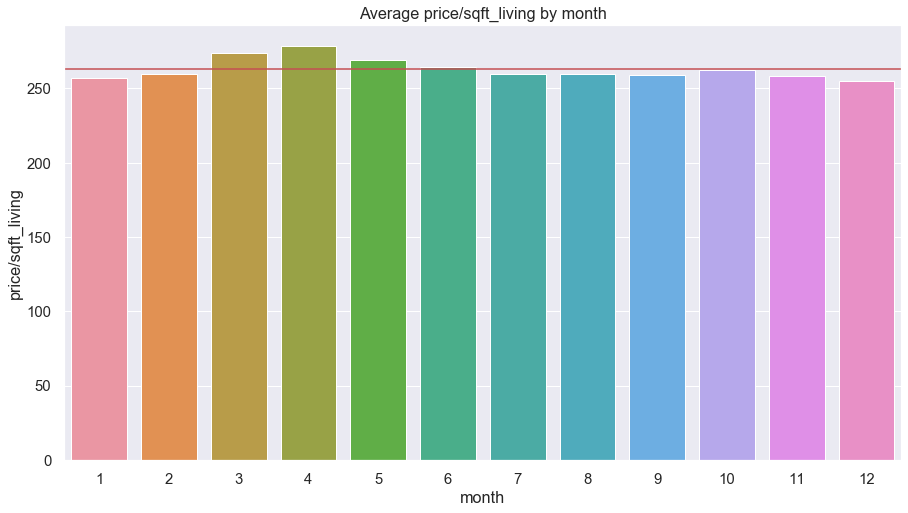

In [127]:
sqft_price_by_month = data.groupby('month')[['price/sqft_living']].mean().reset_index()
sns.lineplot(x=range(-1, 13), y=[sqft_price_by_month['price/sqft_living'].mean()] * 14, color='r')
g = sns.barplot(x='month', y='price/sqft_living', data=sqft_price_by_month)
g.set_title(f'Average price/sqft_living by month');

In [128]:
def season_of_the_year(month):
    if month == 12 or month <= 2:
        return 'Winter'
    if month > 2 and month <= 5:
        return 'Spring'
    if month > 5 and month <= 8:
        return 'Summer'
    if month > 8 and month <= 11:
        return 'Autumn'
        
data['season'] = data['month'].apply(season_of_the_year)

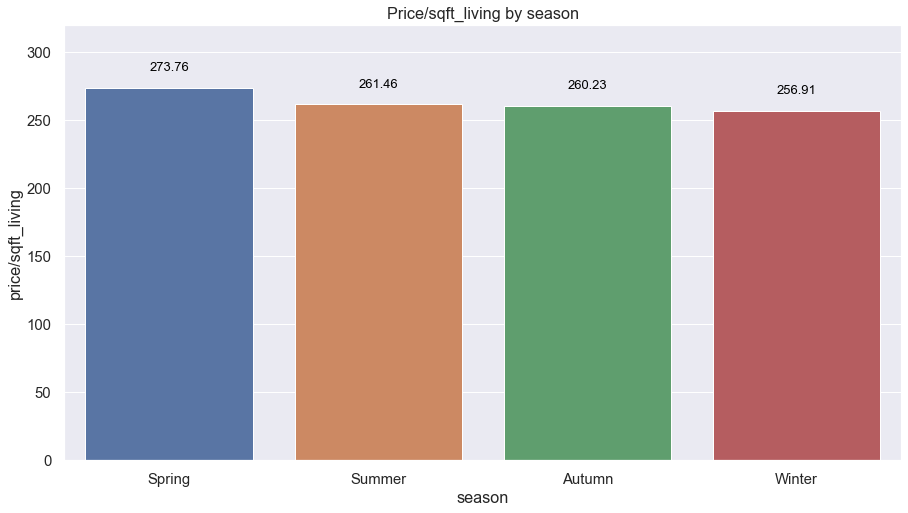

In [129]:
sqft_price_by_season = data.groupby('season')[['price/sqft_living']].mean().reset_index()
g = sns.barplot(x='season', y='price/sqft_living', data=sqft_price_by_season, 
                order=sqft_price_by_season.sort_values('price/sqft_living', ascending=False).season
)

for p in g.patches:
    g.annotate(
        "%.2f" % p.get_height(),(p.get_x() + p.get_width() / 2.,  p.get_height()),
        ha='center', 
        va='center', 
        fontsize=13, 
        color='black', 
        xytext=(0, 20),
        textcoords='offset points'
)
_ = g.set_ylim(0, 320)
g.set_title('Price/sqft_living by season');

In [130]:
def bootstrap_test(data, n_samples, replicate, title):
    bootstrap_test = []
    for i in range(replicate):
        sample_mean = data.sample(n_samples)['price/sqft_living'].values.mean()
        bootstrap_test.append(sample_mean)
    sns.distplot(bootstrap_test).set_title(f'Season: {title} - {median(bootstrap_test)}')

In [131]:
n_samples = 987 # 95% confidence

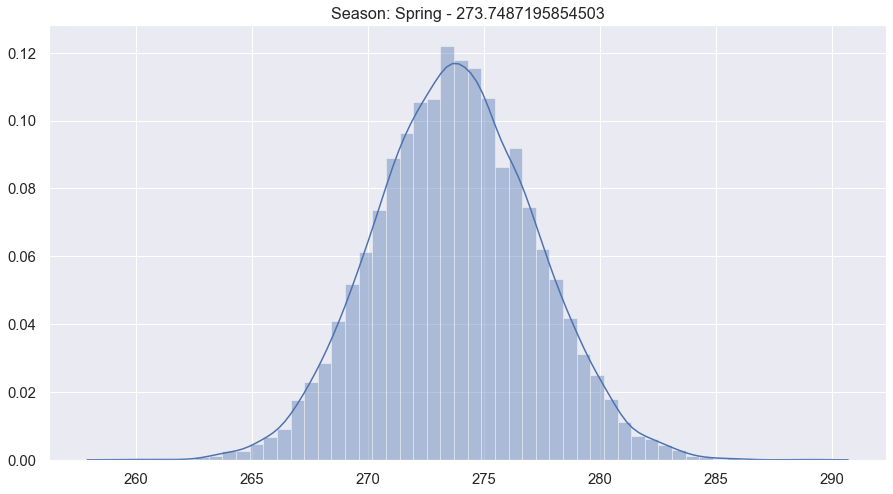

In [132]:
bootstrap_test(data.query('season == "Spring"'), n_samples, 10000, 'Spring')

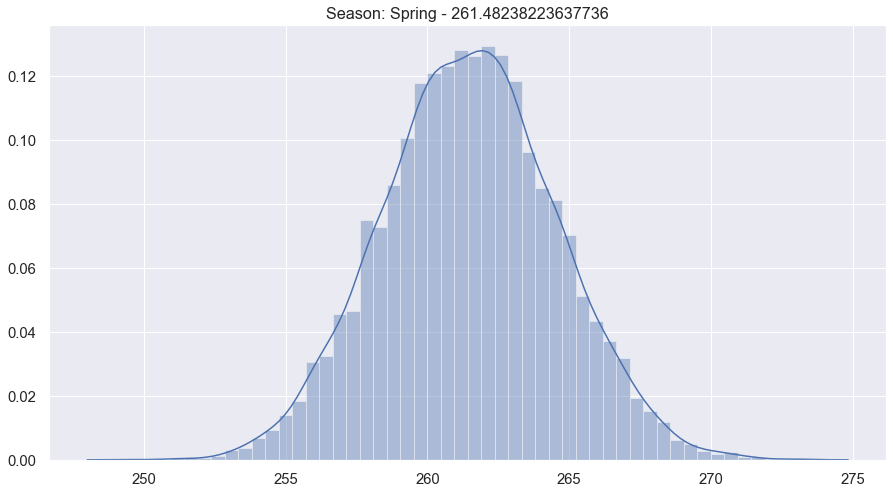

In [133]:
bootstrap_test(data.query('season == "Summer"'), n_samples, 10000, 'Spring')

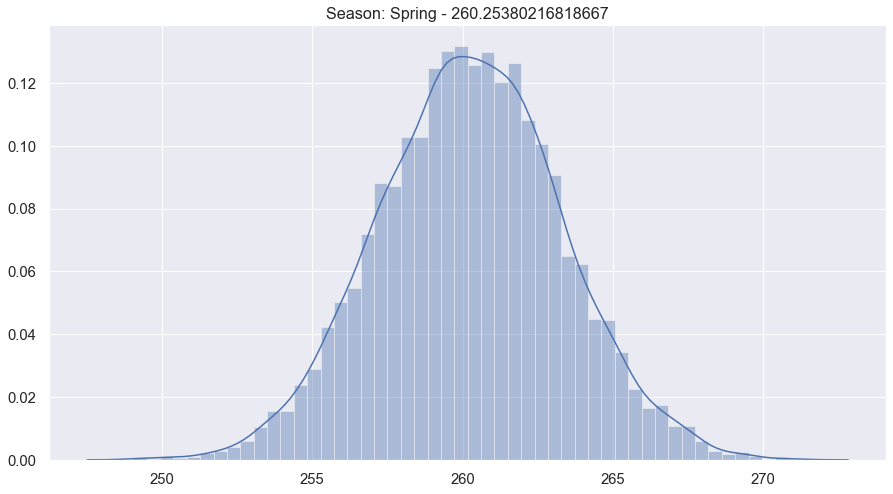

In [134]:
bootstrap_test(data.query('season == "Autumn"'), n_samples, 10000, 'Spring')

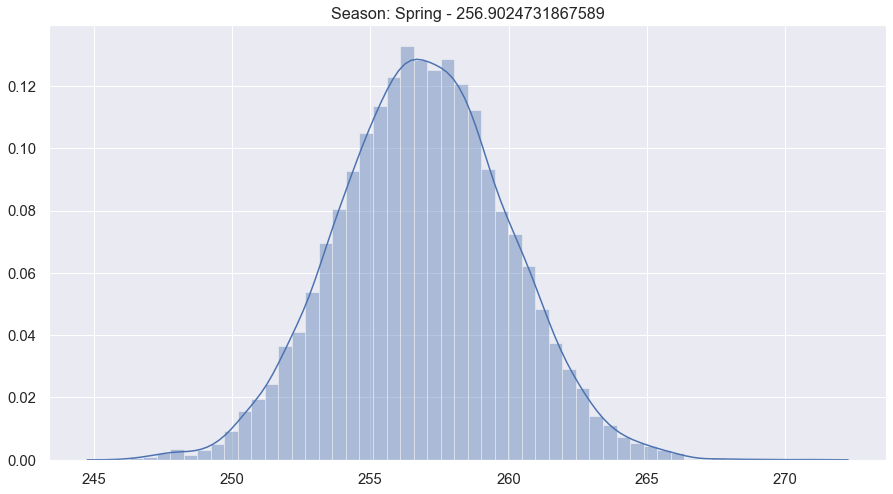

In [135]:
bootstrap_test(data.query('season == "Winter"'), n_samples, 10000, 'Spring')

## Multivariate Analysis

In [136]:
data.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,year,yr_built_yr_sale_dif,renovated,price/sqft_living,price/sqft_lot,sqft_total,price/sqft_total,total_rooms,basement_living,month,part-date,sqft_living/total_rooms,neighborhood,avg_cluster_price,diff_price_cluster,neighborhood_name,season
7129300520,7129300520,2014-10-13,221900.00,3,1.00,1180,5650,1.00,0,0,3,7,1180,0,1955,0,98178,47.51,-122.26,1340,5650,2014,59,0,188.05,39.27,6830,32.49,4.00,0,10,2014-10,295.00,0,437463.79,-215563.79,Seattle South,Autumn
6414100192,6414100192,2014-12-09,538000.00,3,2.00,2570,7242,2.00,0,0,3,7,2170,400,1951,1991,98125,47.72,-122.32,1690,7639,2014,63,1,209.34,74.29,9812,54.83,5.00,1,12,2014-12,514.00,3,628519.07,-90519.07,Seattle North,Winter
5631500400,5631500400,2015-02-25,180000.00,2,1.00,770,10000,1.00,0,0,3,6,770,0,1933,0,98028,47.74,-122.23,2720,8062,2015,82,0,233.77,18.00,10770,16.71,3.00,0,2,2015-02,256.67,5,703994.77,-523994.77,"Redmond, Woodinville & Bellevue North",Winter
2487200875,2487200875,2014-12-09,604000.00,4,3.00,1960,5000,1.00,0,0,5,7,1050,910,1965,0,98136,47.52,-122.39,1360,5000,2014,49,0,308.16,120.80,6960,86.78,7.00,1,12,2014-12,280.00,0,437463.79,166536.21,Seattle South,Winter
1954400510,1954400510,2015-02-18,510000.00,3,2.00,1680,8080,1.00,0,0,3,8,1680,0,1987,0,98074,47.62,-122.05,1800,7503,2015,28,0,303.57,63.12,9760,52.25,5.00,0,2,2015-02,336.00,1,657533.94,-147533.94,Union Hill & Sammamish,Winter


### MA1) Pearson Correlation

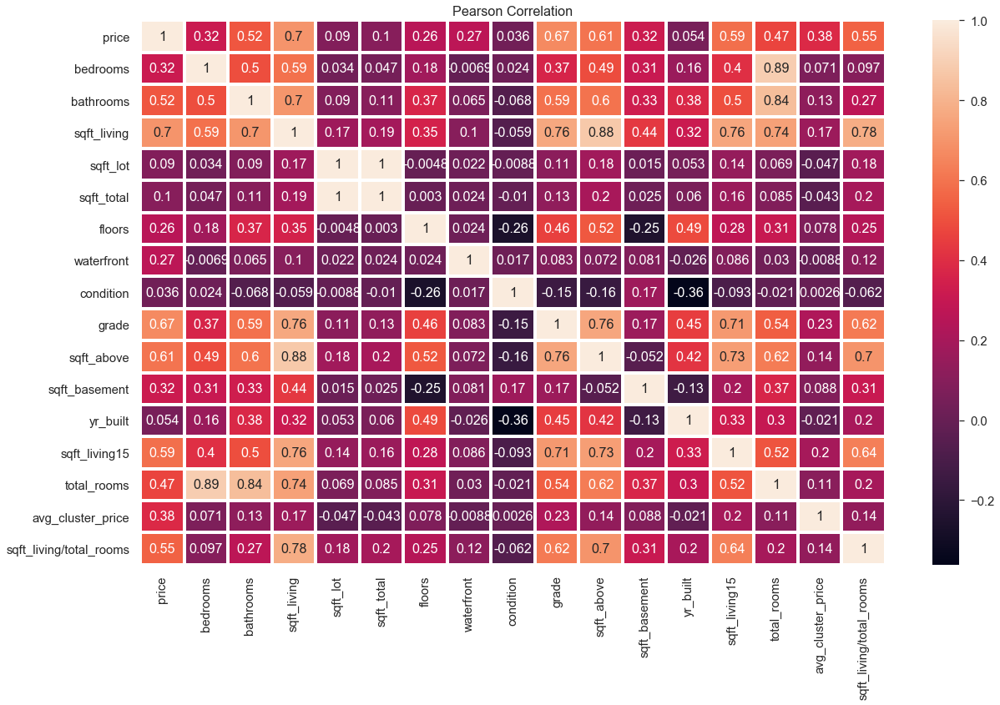

In [137]:
cols_corr = ['price',  'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'sqft_total', 
             'floors', 'waterfront', 'condition', 'grade', 'sqft_above', 'sqft_basement', 
             'yr_built', 'sqft_living15','total_rooms', 'avg_cluster_price', 'sqft_living/total_rooms']

corr_matrix = data[cols_corr].corr(method='pearson')
plt.figure(figsize=(20,12))
sns.set(font_scale=1.35)
g = sns.heatmap(corr_matrix, annot=True, linewidths=3);
g.set_title("Pearson Correlation");

### MA2) Price by scatter

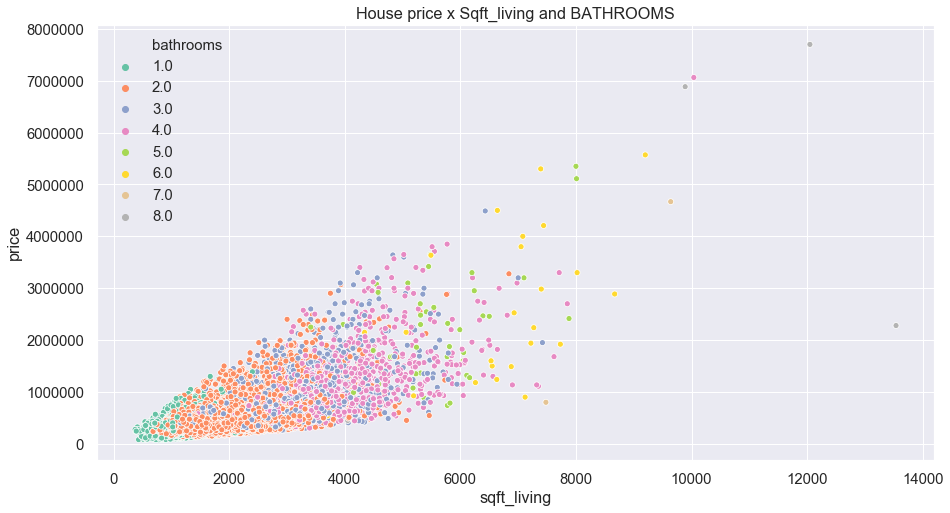

In [138]:
g = sns.scatterplot(x='sqft_living', y='price', hue='bathrooms', data=data, palette='Set2')
g.set_title('House price x Sqft_living and BATHROOMS');
plt.show()

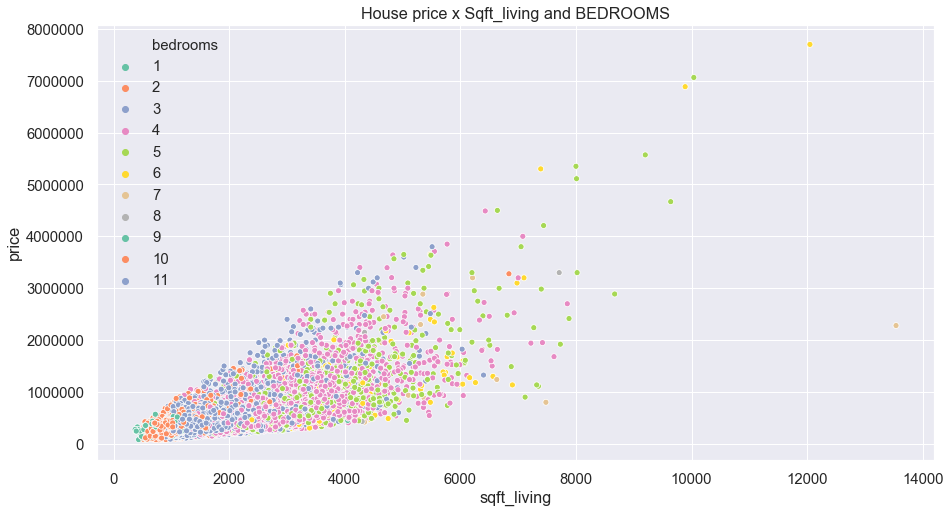

In [139]:
g = sns.scatterplot(x='sqft_living', y='price', hue='bedrooms', data=data, palette='Set2')
g.set_title('House price x Sqft_living and BEDROOMS');
plt.show()

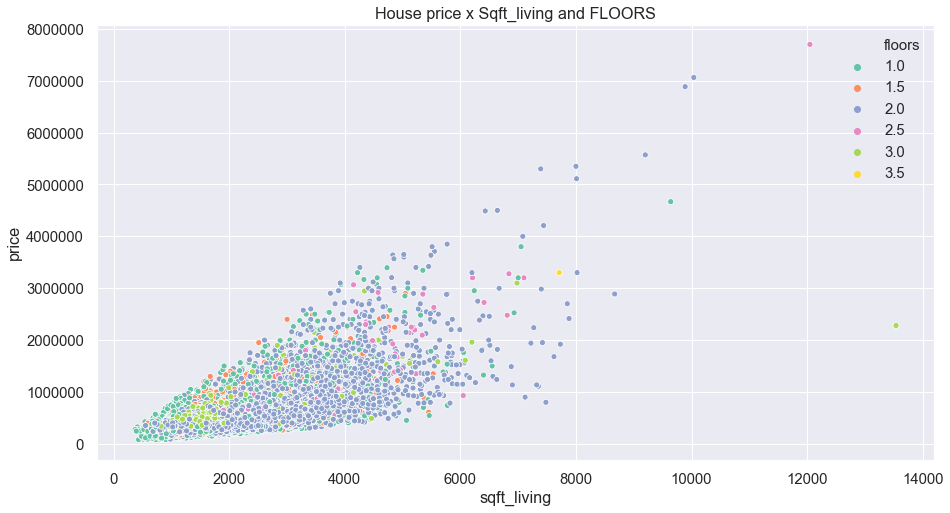

In [140]:
g = sns.scatterplot(x='sqft_living', y='price', hue='floors', data=data, palette='Set2')
g.set_title('House price x Sqft_living and FLOORS');
plt.show()

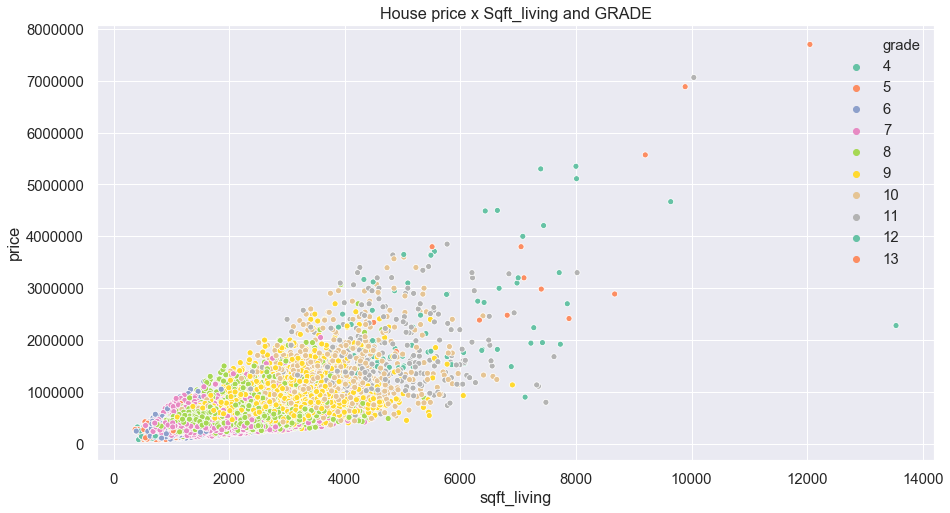

In [141]:
g = sns.scatterplot(x='sqft_living', y='price', hue='grade', data=data, palette='Set2')
g.set_title('House price x Sqft_living and GRADE');
plt.show()

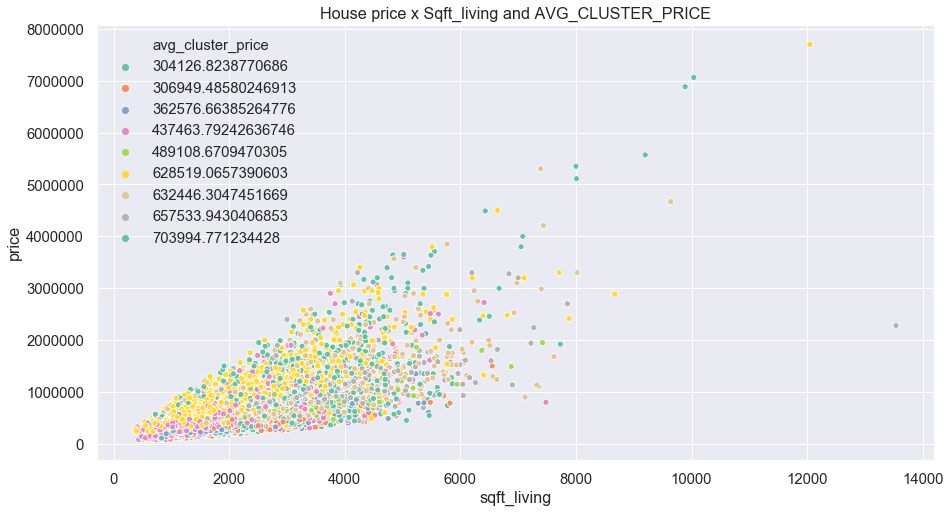

In [142]:
g = sns.scatterplot(x='sqft_living', y='price', hue='avg_cluster_price', data=data, palette='Set2')
g.set_title('House price x Sqft_living and AVG_CLUSTER_PRICE');
plt.show()

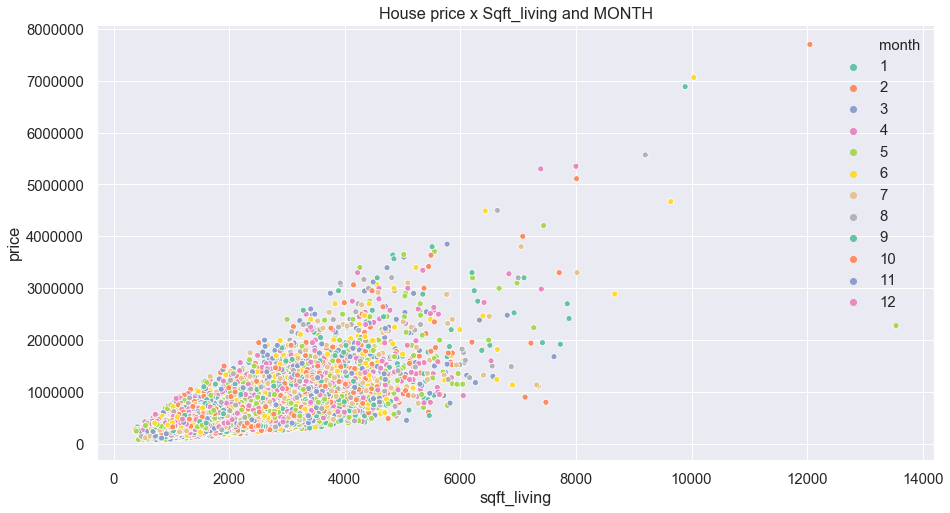

In [143]:
g = sns.scatterplot(x='sqft_living', y='price', hue='month', data=data, palette='Set2')
g.set_title('House price x Sqft_living and MONTH');
plt.show()

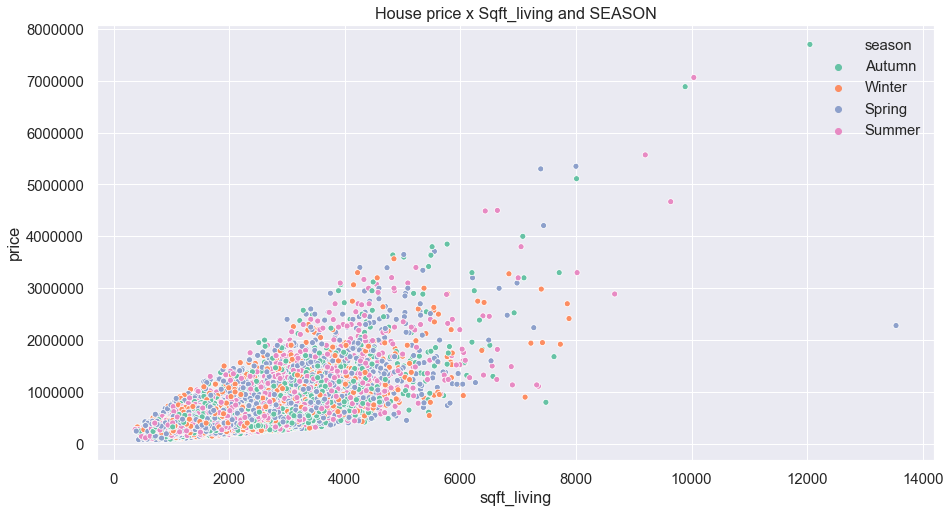

In [144]:
g = sns.scatterplot(x='sqft_living', y='price', hue='season', data=data, palette='Set2')
g.set_title('House price x Sqft_living and SEASON');
plt.show()

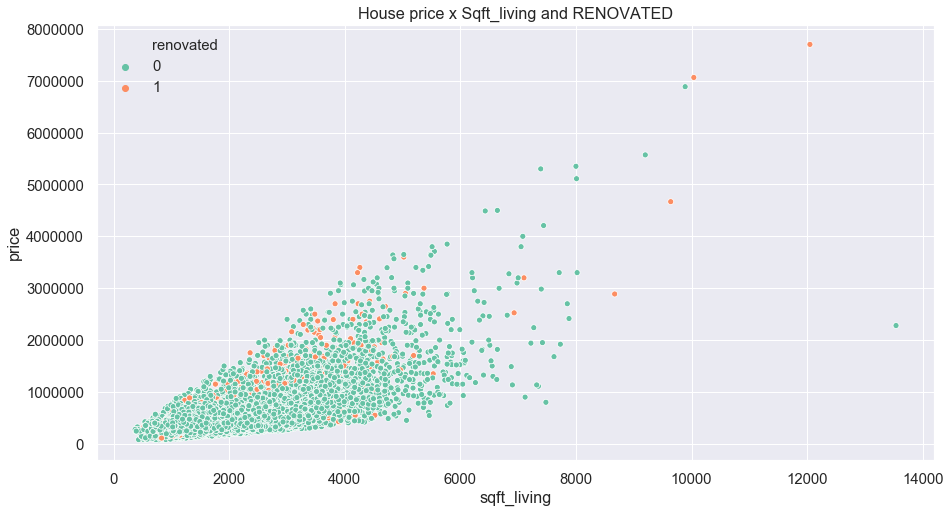

In [145]:
g = sns.scatterplot(x='sqft_living', y='price', hue='renovated', data=data, palette='Set2')
g.set_title('House price x Sqft_living and RENOVATED');
plt.show()

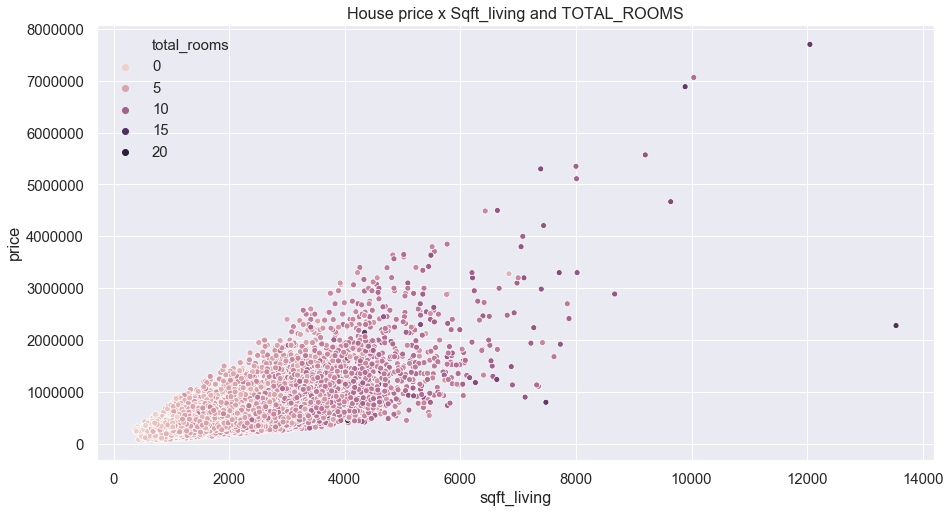

In [146]:
g = sns.scatterplot(x='sqft_living', y='price', hue='total_rooms', data=data)
g.set_title('House price x Sqft_living and TOTAL_ROOMS');
plt.show()

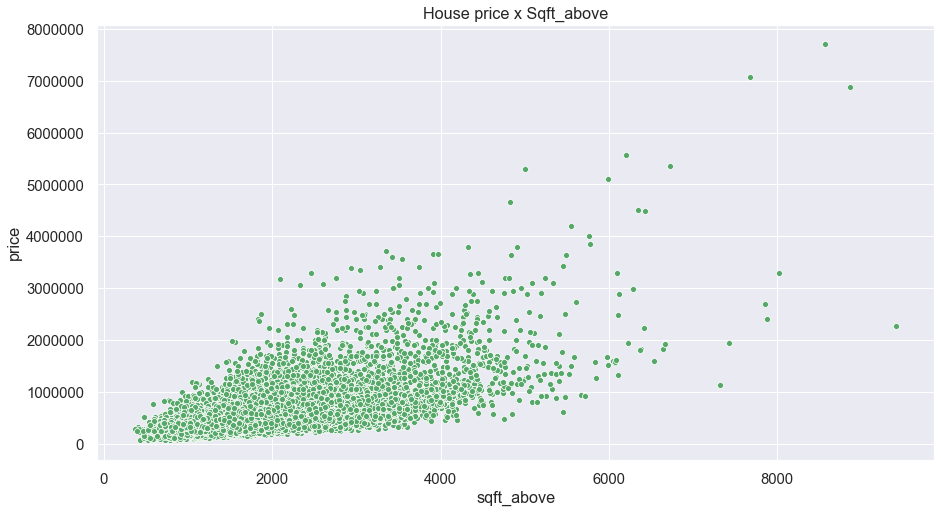

In [147]:
g = sns.scatterplot(x='sqft_above', y='price', data=data, color='g')
g.set_title('House price x Sqft_above');
plt.show()

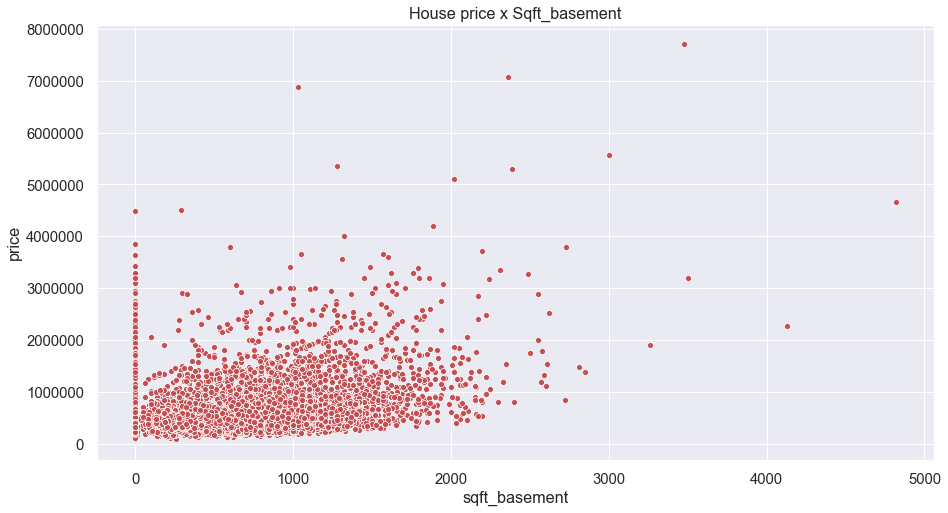

In [148]:
g = sns.scatterplot(x='sqft_basement', y='price', data=data, color='r')
g.set_title('House price x Sqft_basement');
plt.show()

In [149]:
#data['sqft_living/total_rooms'] =  data['sqft_living'] / data['total_rooms']

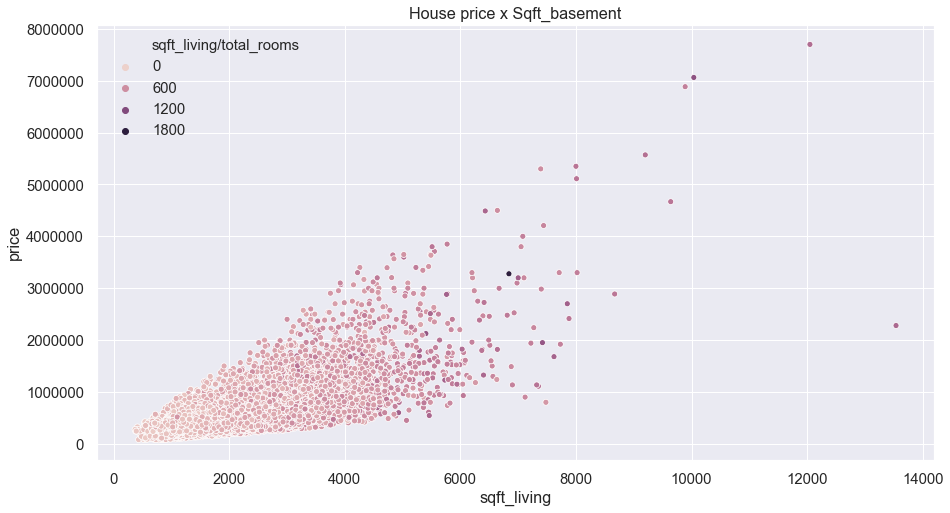

In [150]:
g = sns.scatterplot(x='sqft_living', y='price', hue='sqft_living/total_rooms', data=data)
g.set_title('House price x Sqft_basement');
plt.show()

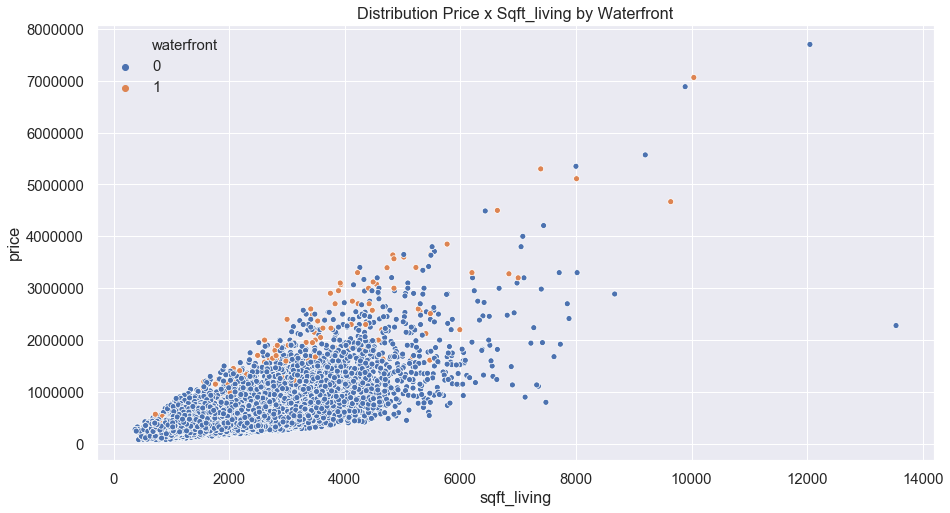

In [156]:
sns.scatterplot(x='sqft_living', y='price', hue='waterfront', data=data).set_title('Distribution Price x Sqft_living by Waterfront');

### MA3) Price by geo-maps

In [162]:
fig = px.scatter_mapbox(data, 
                        lat='lat', 
                        lon='long', 
                        color='view',
                        size='grade',  
                        size_max=15,
                        zoom=10,
                        width=980,
                        height=880,
                        title='Location by price (size) and grade (color)')

fig.show()

In [161]:
palette = ["#9b59b6", "#3498db", "#95a5a6", "#e74c3c", "#34495e", "#2ecc71"]
fig = px.scatter_mapbox(data.query('waterfront == 1'), 
                        lat='lat', 
                        lon='long', 
                        color='price',
                        size='view',  
                        size_max=15,
                        zoom=10,
                        width=980,
                        height=880,
                        title='Location and Price with waterfront = 1',
                        color_continuous_scale=palette)

fig.show()

In [164]:
fig = px.scatter_mapbox(data, 
                        lat='lat', 
                        lon='long', 
                        color='price/sqft_living',
                        size='price/sqft_living',
                        size_max=15,
                        zoom=10,
                        width=980,
                        height=880,
                        title='Price/sqft_living')

fig.show()

In [166]:
fig = px.scatter_mapbox(data, 
                        lat='lat', 
                        lon='long', 
                        color='price/sqft_total',
                        size='price/sqft_total',
                        size_max=15,
                        zoom=10,
                        width=980,
                        height=880,
                        title='Price/sqft_total')

fig.show()

In [168]:
fig = px.scatter_mapbox(data, 
                        lat='lat', 
                        lon='long', 
                        color='price/sqft_lot',
                        size='price/sqft_lot',
                        size_max=15,
                        zoom=10,
                        width=980,
                        height=880,
                        title='Price/sqft_lot')
fig.show()

In [170]:
#palette = ["#9b59b6", "#3498db", "#95a5a6", "#e74c3c", "#34495e", "#2ecc71"]

# Verificando como os clusters foram criados
fig = px.scatter_mapbox(resold, 
                        lat='lat', 
                        lon='long', 
                        color='neighborhood',
                        size='price',
                        zoom=10,
                        width=980,
                        height=880,
                        title='Houses that was resold',
                        #color_continuous_scale=palette
                    )
fig.show()

### MA4) Minimum average percentage increase for each feature

In [184]:
bathrooms_agg = data.groupby(['bathrooms'])[['price']].min()
bathrooms_agg.columns = ['min_price']

bathrooms_agg['diff'] = bathrooms_agg['min_price'] - bathrooms_agg['min_price'].shift()

bathrooms_agg['perc_increase'] = bathrooms_agg['diff'] / bathrooms_agg['min_price'].shift()
bathrooms_agg.fillna(0, inplace=True)
bathrooms_agg

,min_price,diff,perc_increase
bathrooms,,,
1.00,78000.00,0.00,0.00
2.00,107000.00,29000.00,0.37
3.00,154000.00,47000.00,0.44
4.00,216650.00,62650.00,0.41
5.00,300000.00,83350.00,0.38
6.00,540000.00,240000.00,0.80
7.00,800000.00,260000.00,0.48
8.00,450000.00,-350000.00,-0.44


In [185]:
increase_per_bathrooms = bathrooms_agg['diff'].mean() / bathrooms_agg['min_price'].mean() * 100
print(f'Minimum average percentage increase for each added bathroom: {round(increase_per_bathrooms, 2)}%')

Minimum average percentage increase for each added bathroom: 14.06%


In [186]:
bedrooms_agg = data.groupby(['bedrooms'])[['price']].min()
bedrooms_agg.columns = ['min_price']
bedrooms_agg['diff'] = bedrooms_agg['min_price'] - bedrooms_agg['min_price'].shift()
bedrooms_agg['perc_increase'] = bedrooms_agg['diff'] / bedrooms_agg['min_price'].shift()
bedrooms_agg.fillna(0, inplace=True)
bedrooms_agg

,min_price,diff,perc_increase
bedrooms,,,
1,80000.00,0.00,0.00
2,78000.00,-2000.00,-0.03
3,82000.00,4000.00,0.05
4,100000.00,18000.00,0.22
5,133000.00,33000.00,0.33
6,175000.00,42000.00,0.32
7,280000.00,105000.00,0.60
8,340000.00,60000.00,0.21
9,450000.00,110000.00,0.32


In [187]:
increase_per_bedrooms = bedrooms_agg['diff'].mean() / bedrooms_agg['min_price'].mean() * 100
print(f'Minimum average percentage increase for each added bedroom: {round(increase_per_bedrooms, 2)}%')

Minimum average percentage increase for each added bedroom: 15.24%


In [188]:
condition_agg = data.groupby(['condition'])[['price']].min()
condition_agg.columns = ['min_price']
condition_agg['diff'] = condition_agg['min_price'] - condition_agg['min_price'].shift()
condition_agg['perc_increase'] = condition_agg['diff'] / condition_agg['min_price'].shift()
condition_agg.fillna(0, inplace=True)
condition_agg

,min_price,diff,perc_increase
condition,,,
1,78000.00,0.00,0.00
2,80000.00,2000.00,0.03
3,82000.00,2000.00,0.03
4,89000.00,7000.00,0.09
5,110000.00,21000.00,0.24


In [189]:
increase_per_condition = condition_agg['diff'].mean() / condition_agg['min_price'].mean() * 100
print(f'Minimum average percentage increase for each added condition: {round(increase_per_condition, 2)}%')

Minimum average percentage increase for each added condition: 7.29%


In [190]:
grade_agg = data.groupby(['grade'])[['price']].median()
grade_agg.columns = ['min_price']
grade_agg['diff'] = grade_agg['min_price'] - grade_agg['min_price'].shift()
grade_agg['perc_increase'] = grade_agg['diff'] / grade_agg['min_price'].shift()
grade_agg.fillna(0, inplace=True)
grade_agg

,min_price,diff,perc_increase
grade,,,
4,200000.00,0.00,0.00
5,229950.00,29950.00,0.15
6,275500.00,45550.00,0.20
7,375000.00,99500.00,0.36
8,510000.00,135000.00,0.36
9,720000.00,210000.00,0.41
10,914327.00,194327.00,0.27
11,1284000.00,369673.00,0.40
12,1820000.00,536000.00,0.42


In [192]:
increase_per_grade = grade_agg['diff'].mean() / grade_agg['min_price'].mean() * 100
print(f'Minimum average percentage increase for each added grade: {round(increase_per_grade, 2)}%')

Minimum average percentage increase for each added grade: 29.89%


In [193]:
increase_price = [increase_per_grade, increase_per_bathrooms, increase_per_condition, increase_per_bedrooms]
increase_price = [round(e, 2) for e in increase_price]

plot_data = pd.DataFrame(dict(
    values=increase_price,
    desc=['grade', 'bathroom','condition','bedroom'])
)
plot_data

,values,desc
0,29.89,grade
1,14.06,bathroom
2,7.29,condition
3,15.24,bedroom


In [195]:
fig = px.line_polar(plot_data, 
                    r='values', 
                    theta='desc', 
                    line_close=True,
                    title='Minimum average percentage increase for each feature',
)
fig.show()